In [38]:
import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "1"

import sys
sys.path.append("../")
sys.path.append("../../")
import gc
import time
import shutil
import random
import warnings
import typing as tp
from pathlib import Path
from contextlib import contextmanager

from tqdm import tqdm
import yaml
from joblib import delayed, Parallel

import cv2
import librosa
import audioread
import soundfile as sf

import numpy as np
import pandas as pd

from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data
import resnest.torch as resnest_torch

import pytorch_pfn_extras as ppe
from pytorch_pfn_extras.training import extensions as ppe_extensions

from dataset import SpectrogramDataset

def set_seed(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)  # type: ignore
#   torch.backends.cudnn.deterministic = True  # type: ignore
#   torch.backends.cudnn.benchmark = True  # type: ignore


@contextmanager
def timer(name: str) -> None:
    """Timer Util"""
    t0 = time.time()
    print("[{}] start".format(name))
    yield
    print("[{}] done in {:.0f} s".format(name, time.time() - t0))

ROOT = Path.cwd()
INPUT_ROOT = ROOT / "../../machine_sound"#"data" / "wav_data"

def get_loaders_for_training(
    args_dataset: tp.Dict, args_loader: tp.Dict,
    train_file_list: tp.List[str], val_file_list: tp.List[str]
):
    # # make dataset
    train_dataset = SpectrogramDataset(train_file_list, **args_dataset)
    val_dataset = SpectrogramDataset(val_file_list, **args_dataset)
    # # make dataloader
    train_loader = data.DataLoader(train_dataset, **args_loader["train"])
    val_loader = data.DataLoader(val_dataset, **args_loader["val"])

    return train_loader, val_loader, train_dataset, val_dataset

def get_model(args: tp.Dict):
    model =getattr(resnest_torch, args["name"])(pretrained=args["params"]["pretrained"])
    del model.fc
    #print(model)
    # # use the same head as the baseline notebook.
    model.fc = nn.Sequential(
        nn.Linear(2048, 1024), nn.ReLU(), nn.Dropout(p=0.2),
        nn.Linear(1024, 1024), nn.ReLU(), nn.Dropout(p=0.2),
        nn.Linear(1024, args["params"]["n_classes"]), nn.Sigmoid())

    return model



def eval_for_batch(
    args, model, device,
    data, target, loss_func, eval_func_dict={}
):
    """
    Run evaliation for valid

    This function is applied to each batch of val loader.
    """
    model.eval()
    data, target = data.to(device), target.to(device)
    output = model(data)
    # Final result will be average of averages of the same size
    target = target.type_as(output)
    val_loss = loss_func(output, target).item()
    ppe.reporting.report({'val/loss': val_loss})

    for eval_name, eval_func in eval_func_dict.items():
        eval_value = eval_func(output, target).item()
        ppe.reporting.report({"val/{}".format(eval_aame): eval_value})



# 1. Parse dataset and make train/ val folds

tmp_list = []
for decibel_value in INPUT_ROOT.iterdir():
    if decibel_value.is_file():
        continue
    for machine in decibel_value.iterdir():
        if machine.is_file():
            continue
        machine_type = machine.stem
        print(f"Reading files in {machine_type} machine type")
        for id in machine.iterdir():
            if id.is_file():
                continue
            id_type = id.stem
            #print(f"Reading files in {id_type}")
            for operation in id.iterdir():
                if operation.is_file():
                    continue
                operation_type = operation.stem
                assert operation_type in ["normal", "abnormal"], "Expected normal or abnormal"
                for wav_f in operation.iterdir():
                    if wav_f.is_file() and wav_f.suffix == ".wav":
                        tmp_list.append( [machine_type, id_type, operation_type,
                                          wav_f.name, wav_f.as_posix()])

train_all = pd.DataFrame(
    tmp_list, columns=["machine_type", "id_type", "operation_type",
                        "wav_filename", "wav_file_path"])

print(train_all.sample(n=5, random_state=1))
print('All df shape ', train_all.shape)

train_df, test_df = train_test_split(train_all, test_size=0.15, random_state=1234)
train_df, val_df = train_test_split(train_df, test_size=0.15, random_state=1234)


test_df = test_df[test_df['operation_type'].isin(['normal'])]
test_df = test_df[test_df['machine_type'].isin(['pump'])]
print('Train df shape ', train_df.shape)
print('Test df shape ', test_df.shape)



# test_df = pd.concat([train_df[train_df['operation_type'].isin(['abnormal'])], 
#                      val_df[val_df['operation_type'].isin(['abnormal'])],
#                     test_df[test_df['operation_type'].isin(['abnormal'])]])

# train_df = train_df[train_df['operation_type'].isin(['normal'])]
# val_df = val_df[val_df['operation_type'].isin(['normal'])]
# #test_df = test_df[test_df['operation_type'].isin(['abnormal'])]

# print('Train df shape after filtering normal:', train_df.shape)
# print('Test df shape after filtering normal:', test_df.shape)


#TODO: Here we can select to use only normal or abnormal data for training

train_file_list = train_df[["wav_file_path", "machine_type"]].values.tolist()
val_file_list = val_df[["wav_file_path", "machine_type"]].values.tolist()
test_file_list = test_df[["wav_file_path", "machine_type"]].values.tolist()

print("train: {}, val: {}, test: {}".format(len(train_file_list), len(val_file_list), len(test_file_list)))

with open('../test_config.yaml') as settings_str:
    settings = yaml.safe_load(settings_str)

for k, v in settings.items():
    print("[{}]".format(k))
    print(v)

set_seed(settings["globals"]["seed"])
device = torch.device(settings["globals"]["device"])
output_dir = Path(settings["globals"]["output_dir"])

# # # get loader
_, test_loader, _, test_dataset = get_loaders_for_training(
    settings["dataset"]["params"], settings["loader"], train_file_list, test_file_list)

train_loader, val_loader, train_dataset, val_dataset = get_loaders_for_training(
    settings["dataset"]["params"], settings["loader"], train_file_list, val_file_list)

# # # get model
model = get_model(settings["model"])
model = model.to(device)

Reading files in pump machine type
Reading files in .ipynb_checkpoints machine type
Reading files in abnormal machine type
Reading files in normal machine type
Reading files in slider machine type
Reading files in slider machine type
Reading files in pump machine type
Reading files in pump machine type
Reading files in fan machine type
Reading files in fan machine type
Reading files in fan machine type
Reading files in valve machine type
Reading files in valve machine type
Reading files in slider machine type
Reading files in valve machine type
      machine_type id_type operation_type  wav_filename  \
23392          fan   id_00         normal  00000026.wav   
16946         pump   id_04         normal  00000318.wav   
33934          fan   id_00         normal  00000137.wav   
37262          fan   id_02         normal  00000892.wav   
10030       slider   id_00         normal  00000347.wav   

                                           wav_file_path  
23392  /home/ubuntu/anudeep/machine

In [39]:
# Load weights
import glob
from collections import defaultdict
load_path = ''
weight_files = glob.glob("../training_output_2cls/*.pth")#"#preprocess*")
weight_files.sort()
#print(weight_files)

curr = weight_files[0]
for ctr, k in enumerate(weight_files):
    print(ctr, "\t", weight_files[ctr])
    curr = k 
    
indx = int(input("please enter your selection"))
load_path = weight_files[indx]

model.load_state_dict(torch.load(load_path))
model.eval()

0 	 ../training_output_2cls/snapshot_epoch_1.pth
1 	 ../training_output_2cls/snapshot_epoch_11.pth
2 	 ../training_output_2cls/snapshot_epoch_13.pth
3 	 ../training_output_2cls/snapshot_epoch_14.pth
4 	 ../training_output_2cls/snapshot_epoch_17.pth
5 	 ../training_output_2cls/snapshot_epoch_2.pth
6 	 ../training_output_2cls/snapshot_epoch_27.pth
7 	 ../training_output_2cls/snapshot_epoch_28.pth
8 	 ../training_output_2cls/snapshot_epoch_3.pth
9 	 ../training_output_2cls/snapshot_epoch_5.pth
10 	 ../training_output_2cls/snapshot_epoch_7.pth
11 	 ../training_output_2cls/snapshot_epoch_8.pth
please enter your selection7


ResNet(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): SplAtConv2d(
        (conv): Conv2d

In [3]:
from tqdm import tqdm
with torch.no_grad():
    test_len = len(test_df)
    test_batch_size = settings["loader"]["val"]["batch_size"]
    test_steps_per_epoch = int(test_len / test_batch_size)

    test_iter = iter(test_loader)
    preds = []
    gts = []
    for k in tqdm(range(test_steps_per_epoch)):
        x, y = next(test_iter)
        data, target = x.to('cuda'), y.to('cuda')
        y_pred = model(data)
        preds.append(y_pred.cpu().numpy())
        gts.append(y.cpu().numpy())

        #print(k/test_steps_per_epoch, end="\r", flush=True)
        del x, y , data, target, y_pred
    

100%|██████████| 61/61 [00:49<00:00,  1.23it/s]


In [4]:
preds = np.array(preds)
gts = np.array(gts)
preds = np.concatenate(preds, axis=0)
gts = np.concatenate(gts, axis=0)
_preds = np.argmax(preds, axis=-1)
_gts = np.argmax(gts, axis=-1)
_preds.shape, _gts.shape

((1464,), (1464,))

In [5]:
model.layer4[-3].downsample[1]

Conv2d(1024, 2048, kernel_size=(1, 1), stride=(1, 1), bias=False)

# Performance metrics

/home/ubuntu/anudeep/miniconda3/envs/pytorch_machine/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ubuntu/anudeep/miniconda3/envs/pytorch_machine/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ubuntu/anudeep/miniconda3/envs/pytorch_machine/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average,

              precision    recall  f1-score   support

      normal       0.00      0.00      0.00         0
    abnormal       1.00      0.97      0.98      1464

    accuracy                           0.97      1464
   macro avg       0.50      0.48      0.49      1464
weighted avg       1.00      0.97      0.98      1464



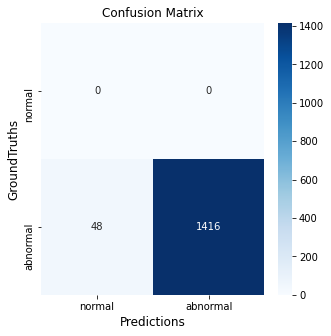

In [6]:
import sklearn
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt

target_names = ["normal", "abnormal"]#["pump", "valve", "slider", "fan"]
print(sklearn.metrics.classification_report(_gts, _preds, target_names=target_names))

array = sklearn.metrics.confusion_matrix(_gts, _preds)
df_cm = pd.DataFrame(array, index = [i for i in target_names],
                  columns = [i for i in target_names])
plt.figure(figsize = (5,5))
sn.heatmap(df_cm, annot=True, fmt='g', cmap='Blues')
plt.xlabel('Predictions', fontsize=12)
plt.ylabel('GroundTruths', fontsize=12)
plt.title('Confusion Matrix', fontsize=12)

plt.show()

# CAM VIS

In [10]:
import sys
import ttach
sys.path.append('./pytorch-grad-cam')
from pytorch_grad_cam import GradCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
from torchvision.models import resnet50

In [40]:
test_iter = iter(test_loader)

In [41]:
x, y = next(test_iter)
data, target = x.to('cuda'), y.to('cuda')
data.shape

torch.Size([24, 3, 224, 1095])

In [11]:
target_layers = [model.layer4[-3].downsample[1]]#[model.avgpool]
cam = XGradCAM(model=model, target_layers=target_layers, use_cuda=True)

In [12]:
def run():

    input_tensor = data# Create an input tensor image for your model..


    # You can also use it within a with statement, to make sure it is freed,
    # In case you need to re-create it inside an outer loop:
    # with GradCAM(model=model, target_layers=target_layers, use_cuda=args.use_cuda) as cam:
    #   ...

    # If target_category is None, the highest scoring category
    # will be used for every image in the batch.
    # target_category can also be an integer, or a list of different integers
    # for every image in the batch.
    target_category = 1

    # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
    grayscale_cam = cam(input_tensor=input_tensor, target_category=target_category)

    target_category = 0

    # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
    grayscale_cam_0 = cam(input_tensor=input_tensor, target_category=target_category)

    # In this example grayscale_cam has only one image in the batch:
    #grayscale_cam = grayscale_cam[0, :]
    #visualization = show_cam_on_image(np.moveaxis(data[0].cpu().numpy(), 0, 2), grayscale_cam, use_rgb=True)
    
    return grayscale_cam, grayscale_cam_0

In [42]:
grayscale_cam, grayscale_cam_0 = run()

In [43]:
data2 = data.cpu().numpy()
target2 = target.cpu().numpy()

[1. 0.]
5.95132e-17 0.0 4.3288707e-15


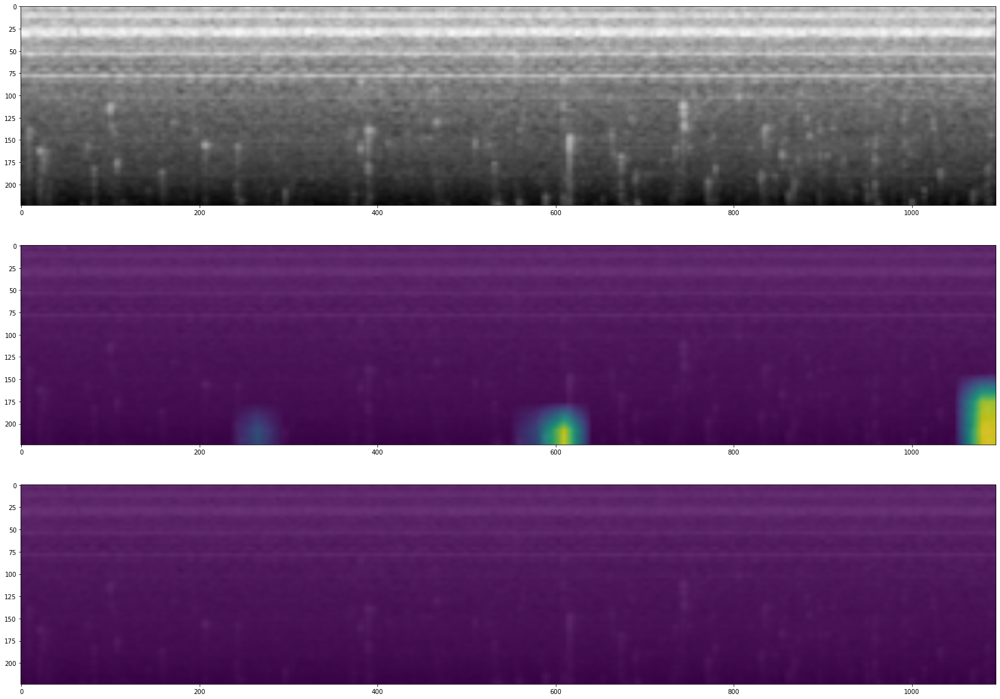

[1. 0.]
0.0 0.0 0.0


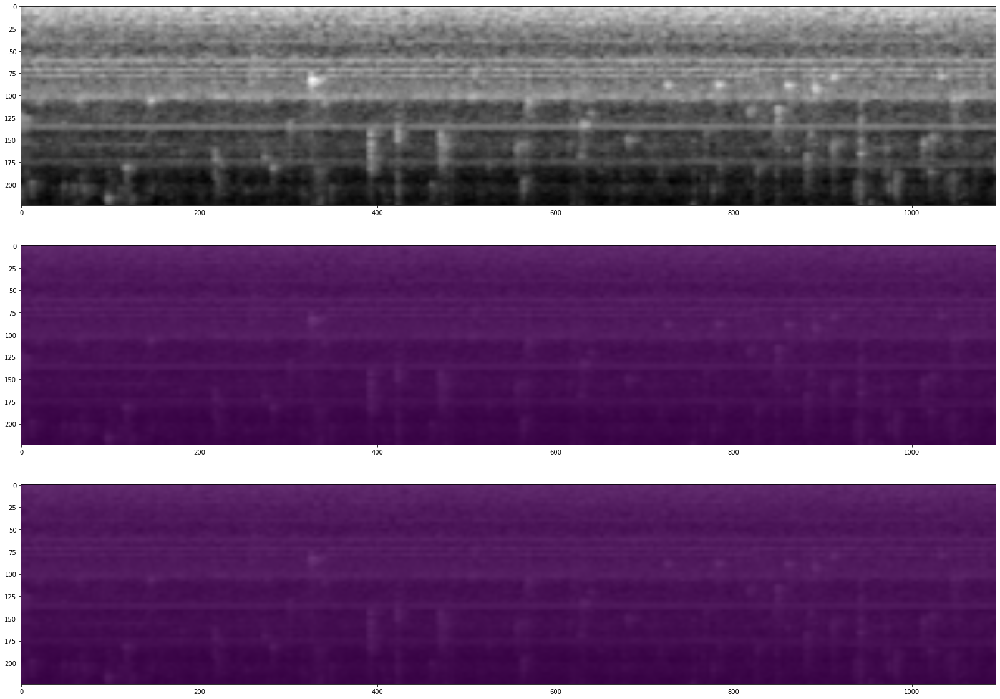

[1. 0.]
0.049351186 0.0 0.99999946


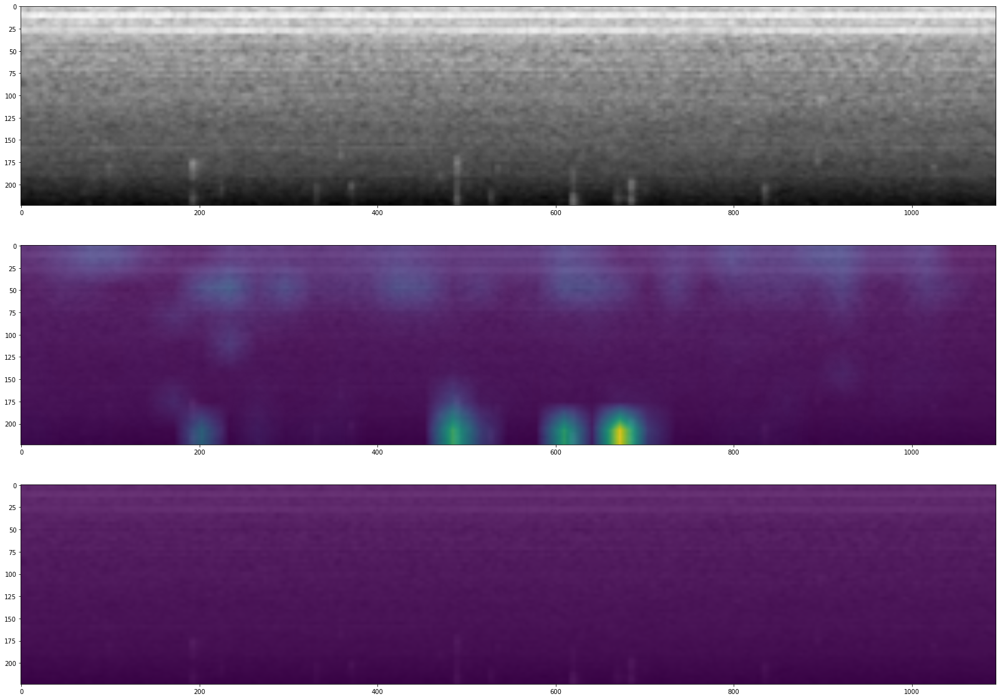

[1. 0.]
0.02230207 0.0 0.99967057


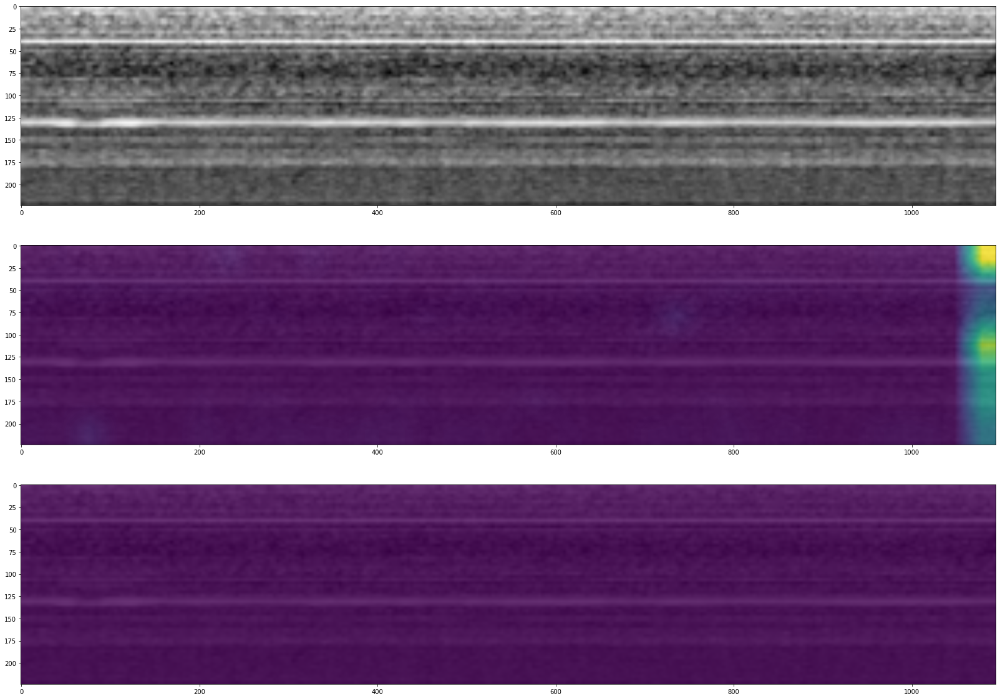

[1. 0.]
1.8469221e-17 0.0 3.403981e-16


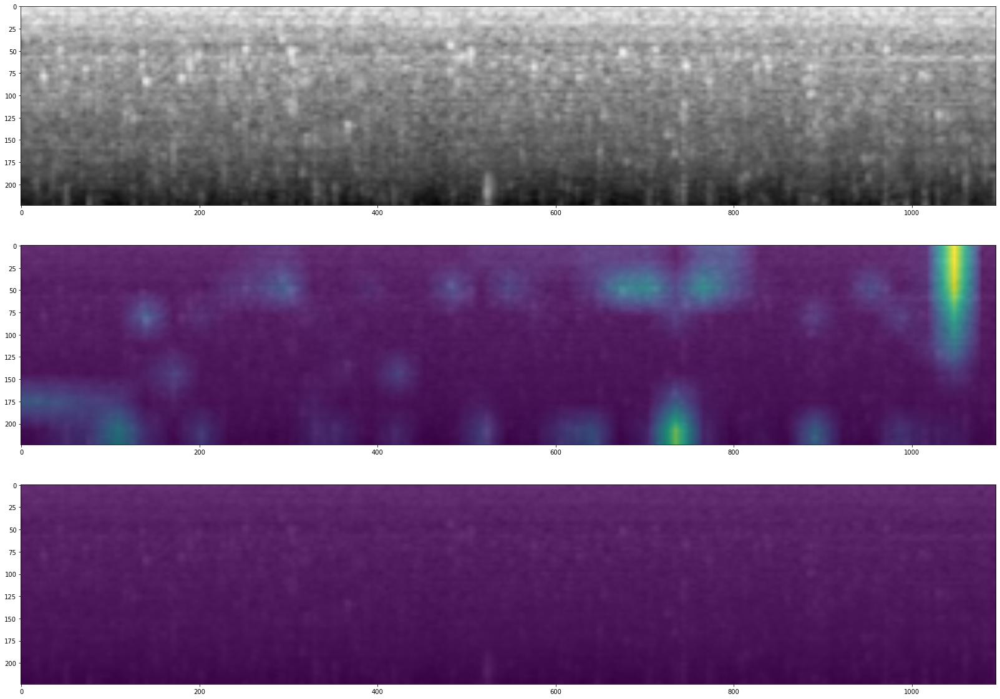

[1. 0.]
7.975457e-17 0.0 6.0803125e-15


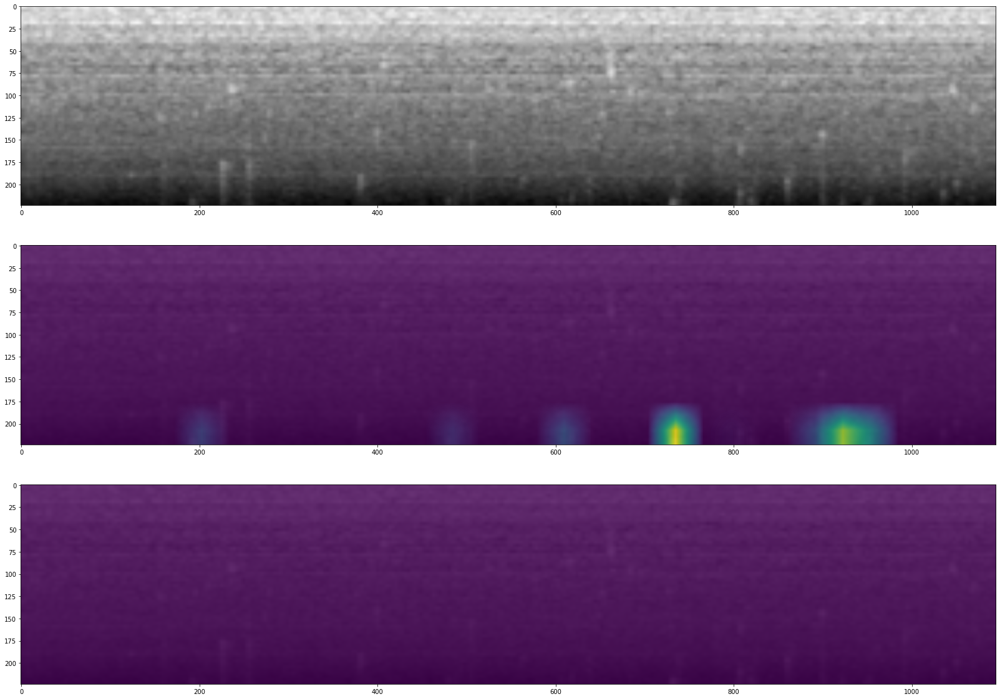

[1. 0.]
0.0 0.0 0.0


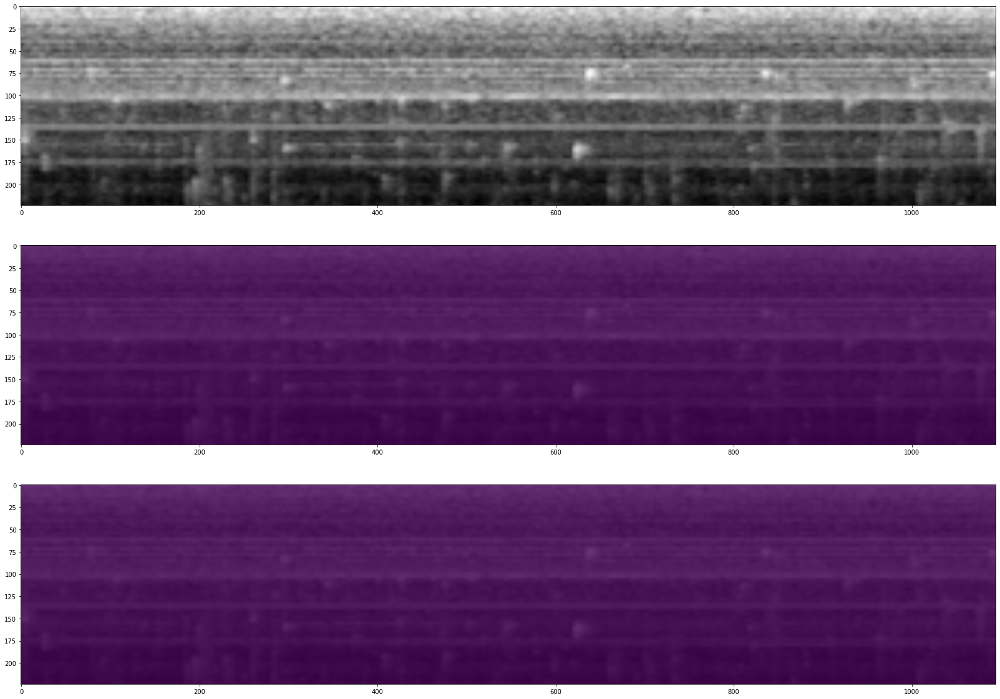

[1. 0.]
0.045052424 0.0 0.9999998


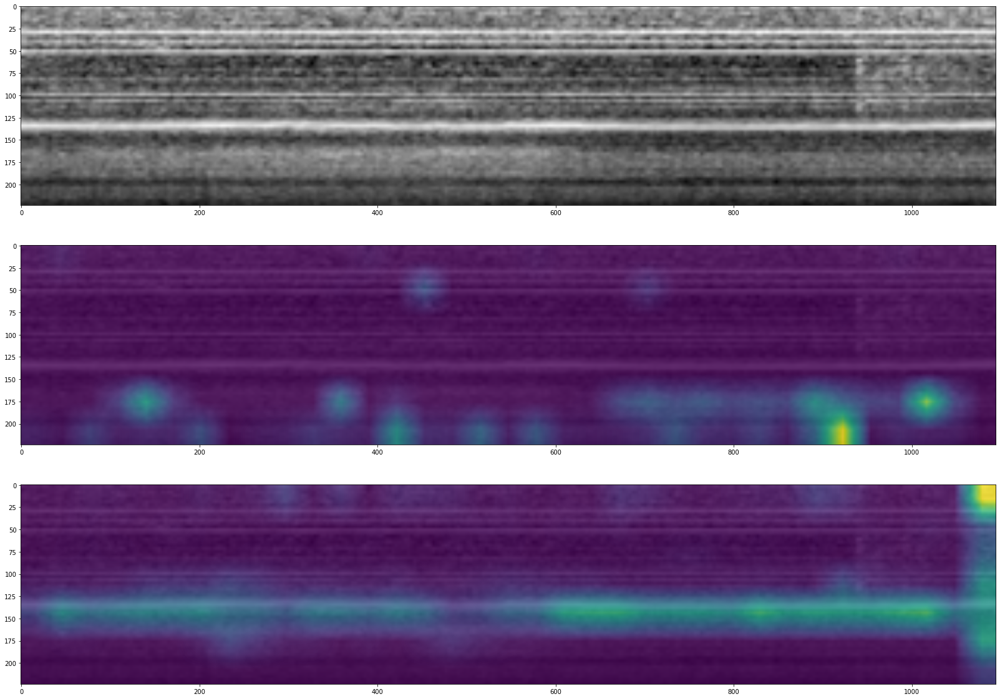

[1. 0.]
0.036116123 0.0 0.9999895


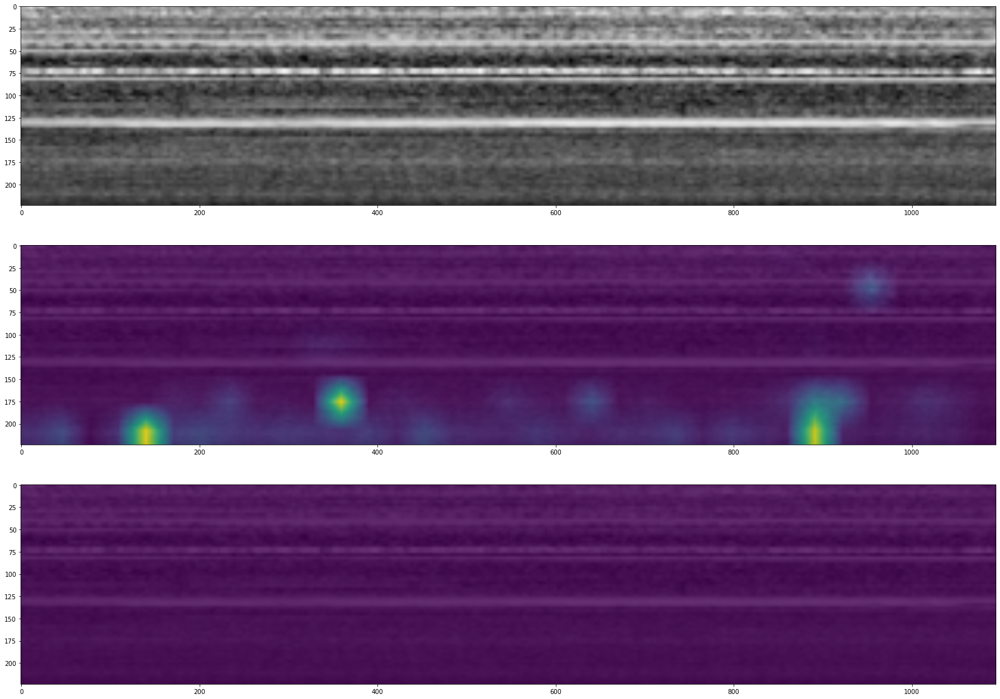

[1. 0.]
0.007242196 0.0 0.8596304


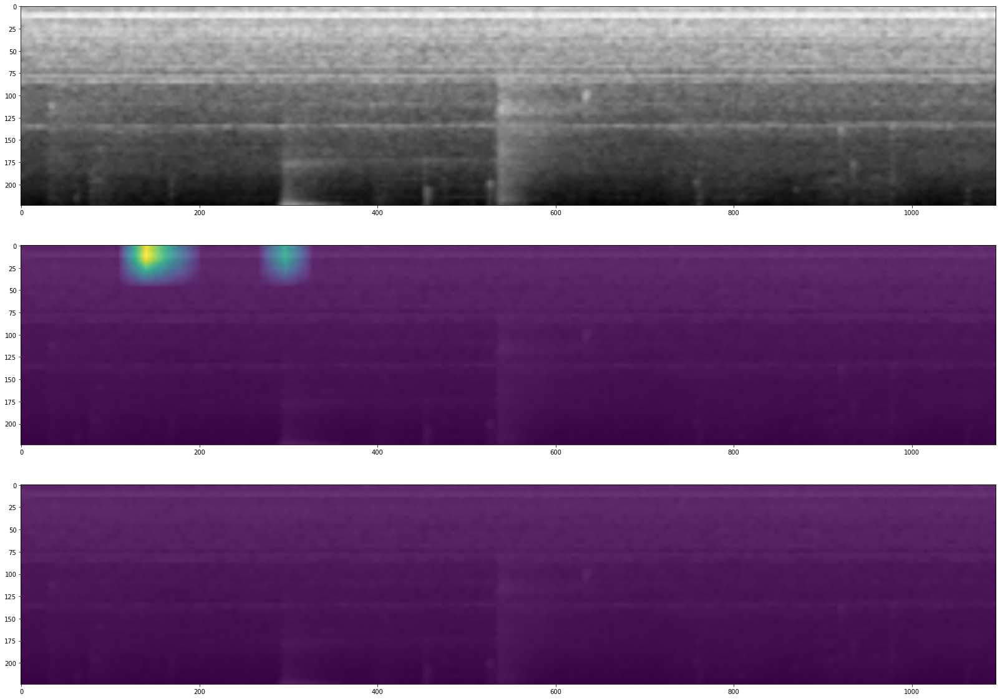

[1. 0.]
0.00018109249 0.0 0.0072050174


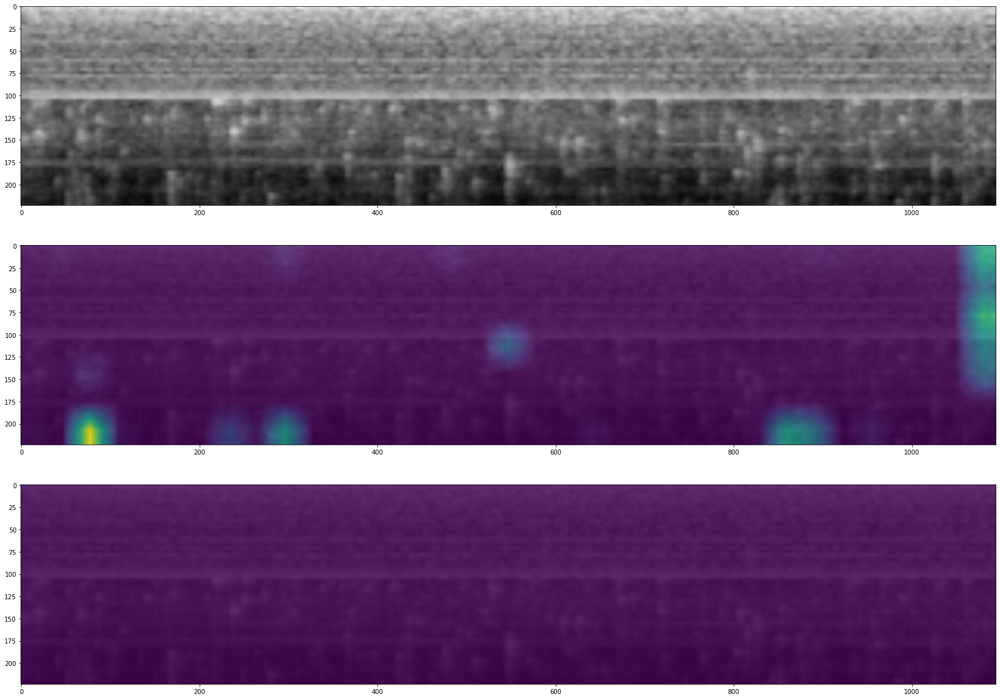

[1. 0.]
0.13275053 0.0 0.9999999


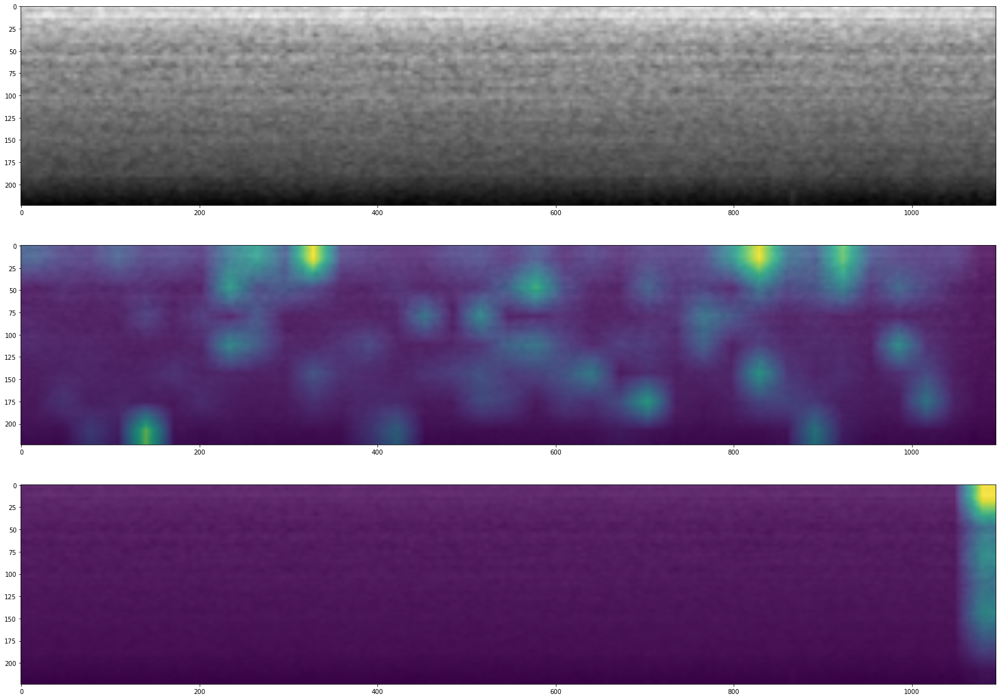

[1. 0.]
0.08702382 0.0 0.9999999


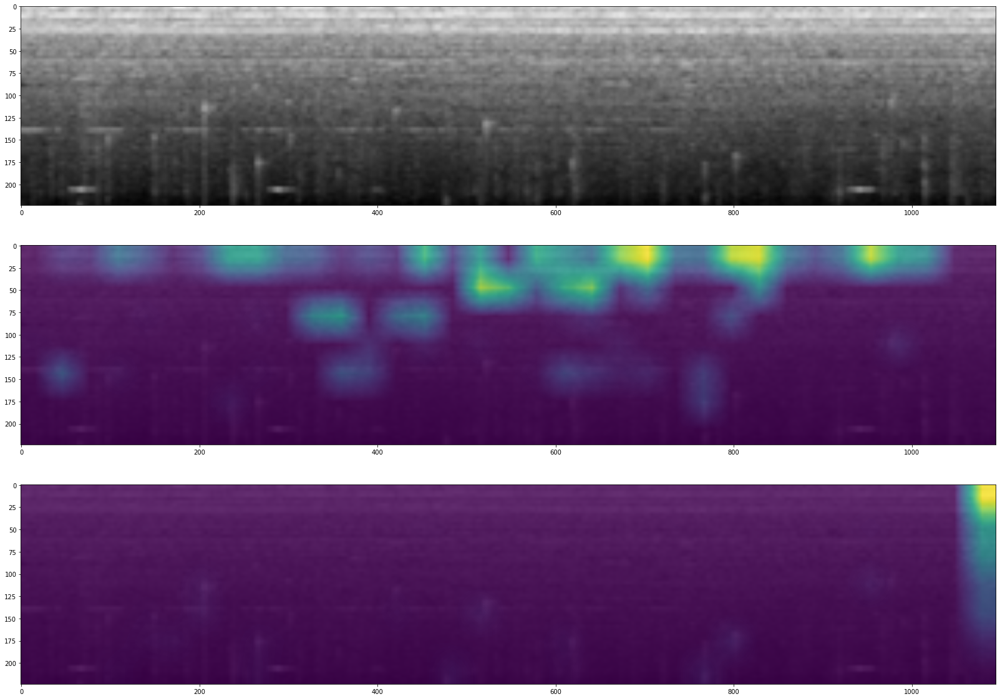

[1. 0.]
0.017791627 0.0 0.9999999


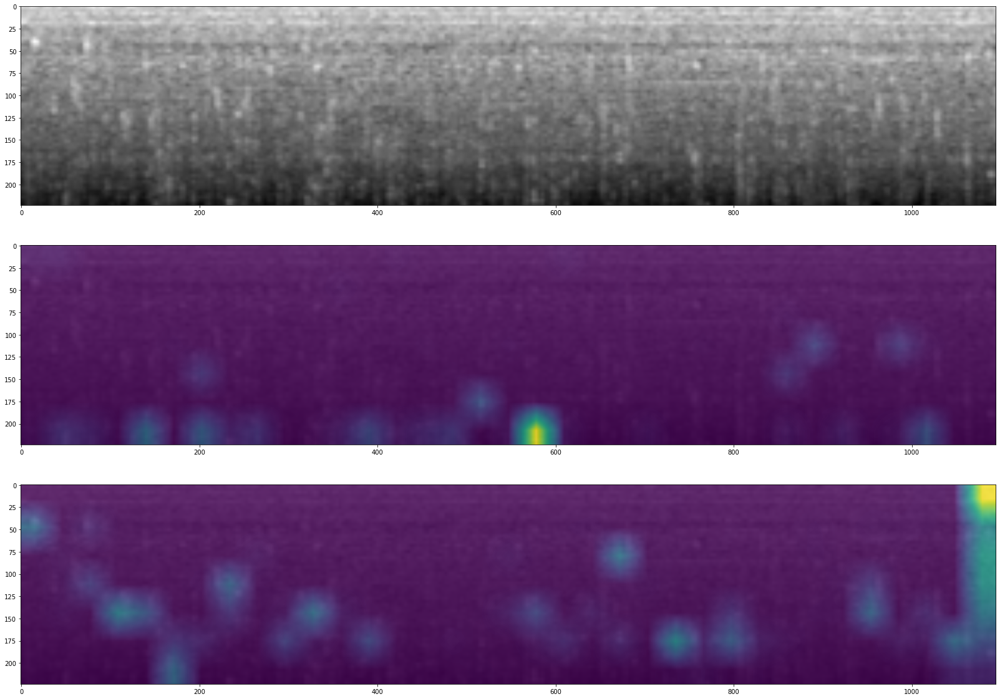

[1. 0.]
0.012299317 0.0 0.9999999


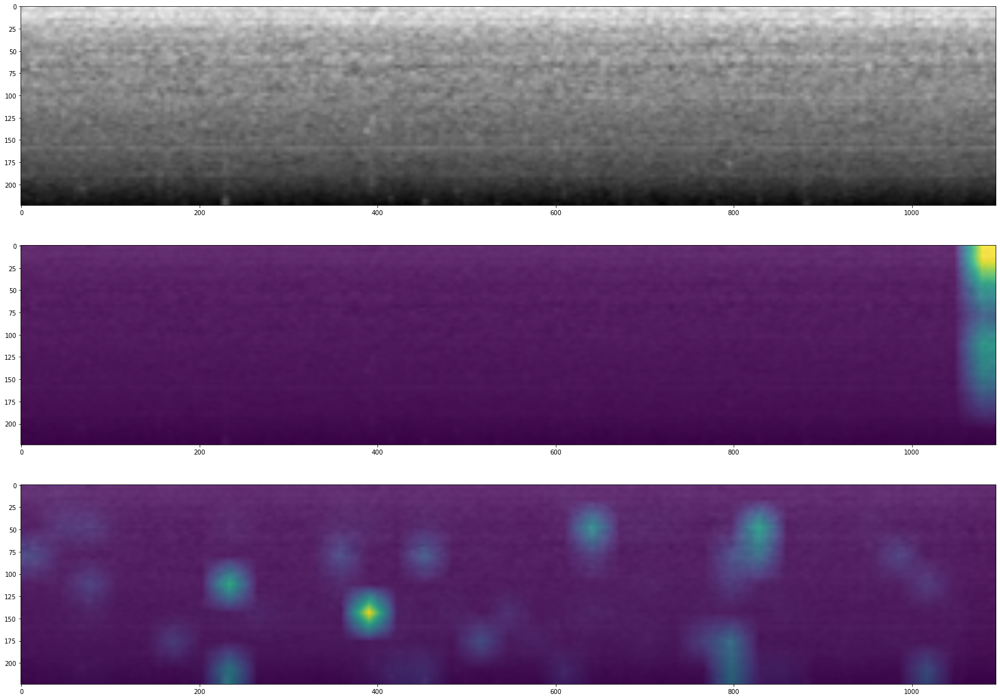

[1. 0.]
0.107893124 0.0 0.9999755


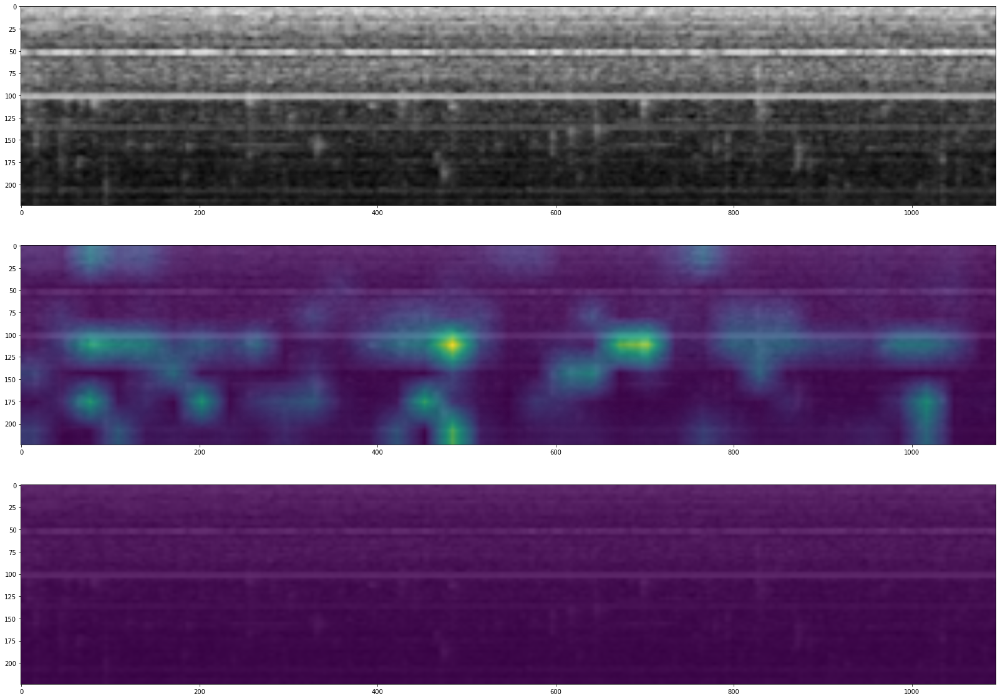

[1. 0.]
6.213334e-25 0.0 3.7934854e-23


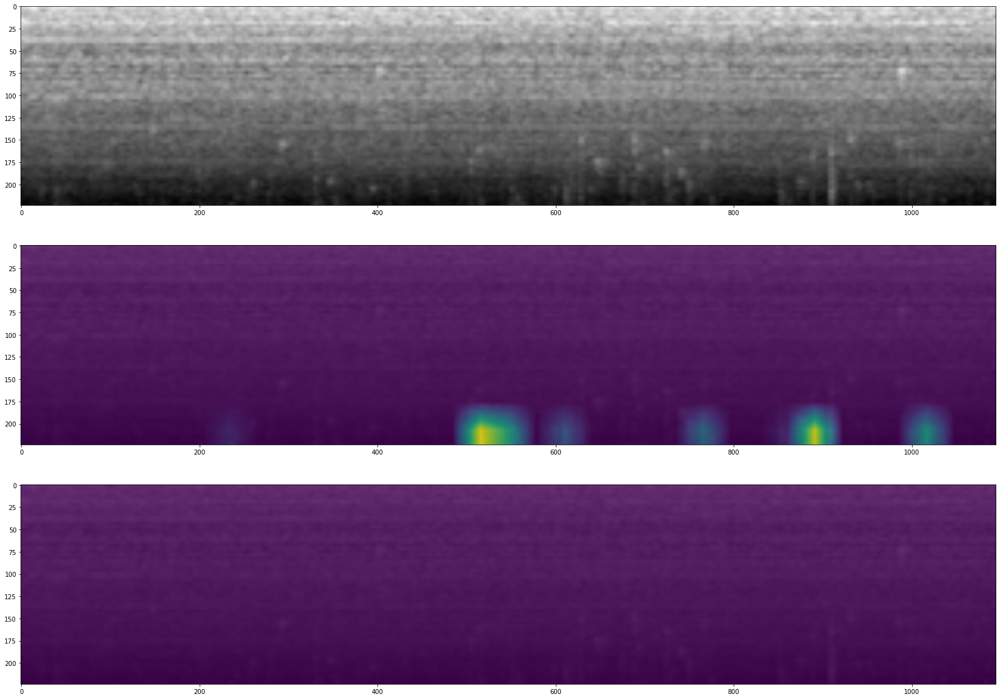

[1. 0.]
0.11939729 0.0 0.9999998


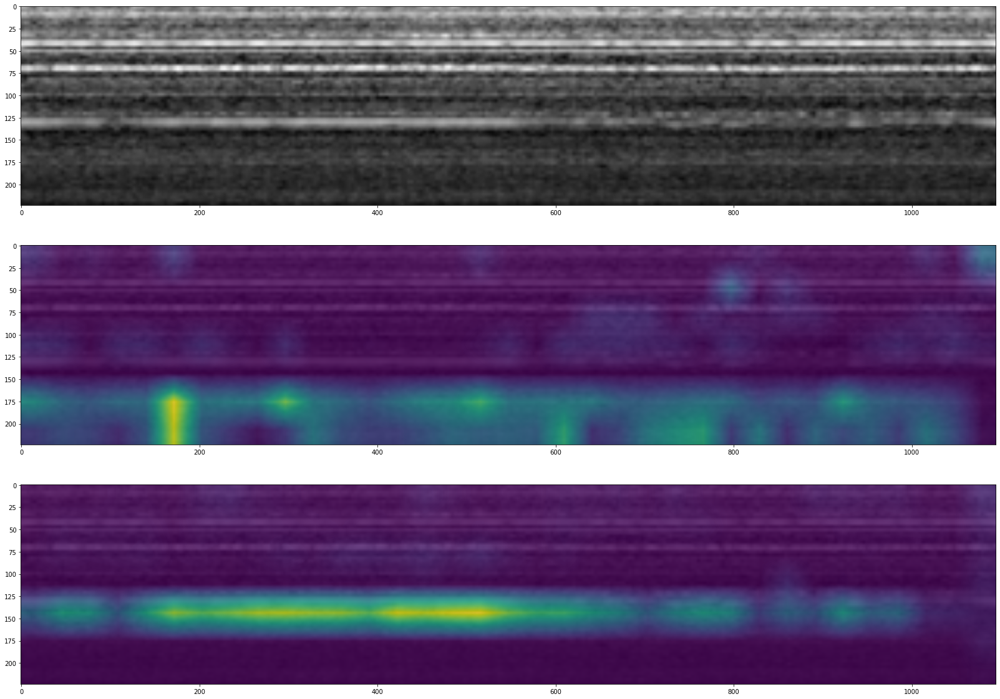

[1. 0.]
0.0 0.0 0.0


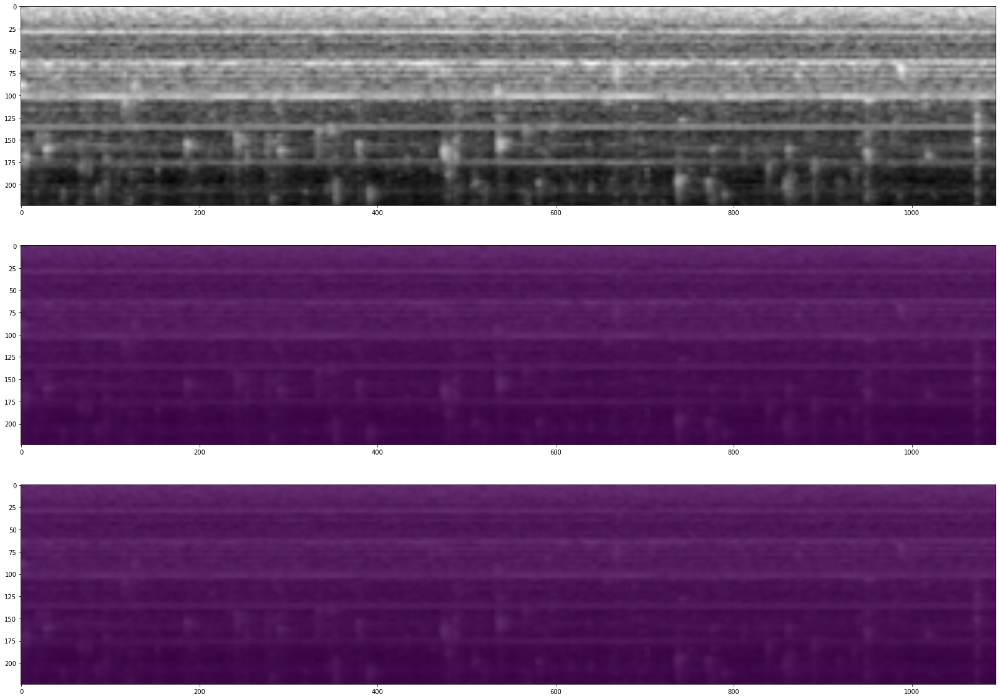

[1. 0.]
0.0 0.0 0.0


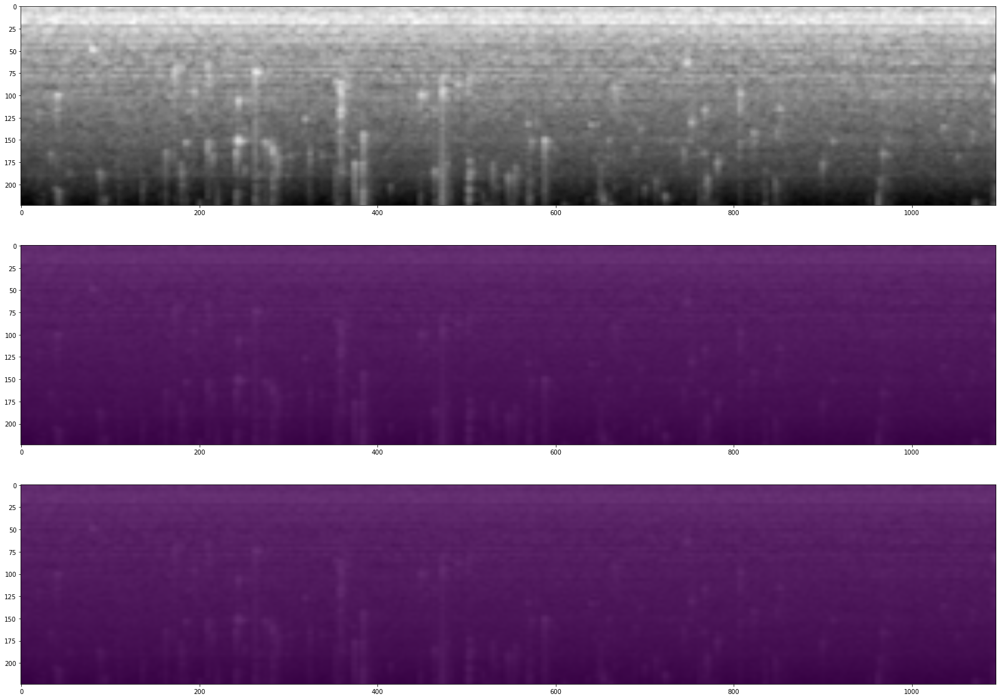

[1. 0.]
0.02080731 0.0 0.99999124


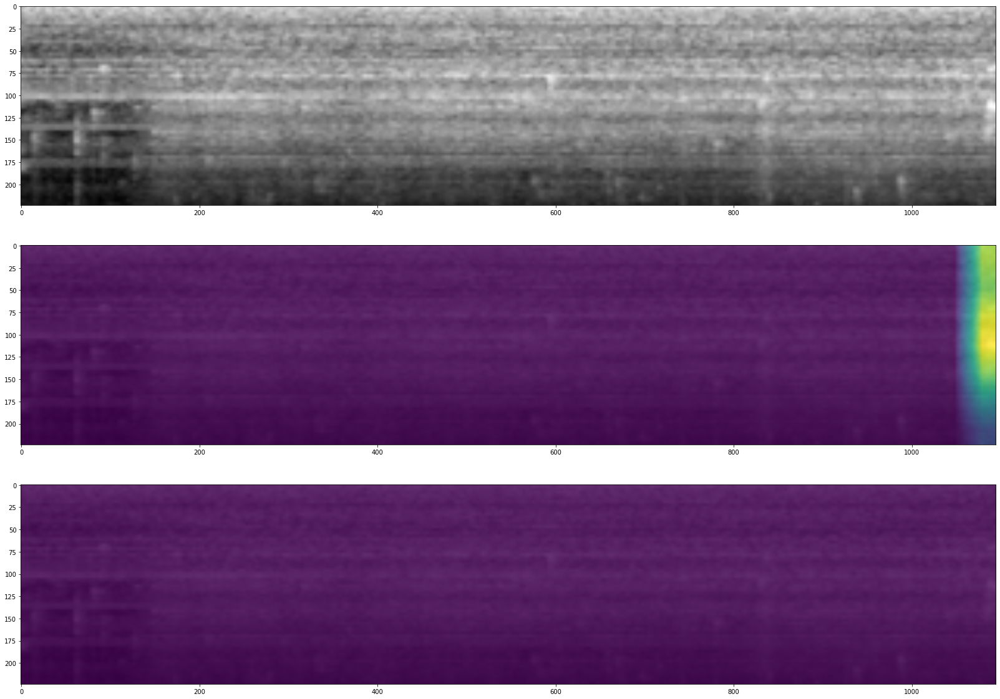

In [44]:
for k in range(21):
    print(target2[k])
    f, ax = plt.subplots(3, 1, figsize=(30, 20))
    ax[0].imshow(np.moveaxis(data2[k], 0, 2))
    print(np.mean(grayscale_cam[k]), np.amin(grayscale_cam[k]), np.amax(grayscale_cam[k]))
    ax[1].imshow(np.moveaxis(data2[k], 0, 2))
    ax[1].imshow(grayscale_cam[k], alpha=0.8)
    ax[2].imshow(np.moveaxis(data2[k], 0, 2))
    ax[2].imshow(grayscale_cam_0[k], alpha=0.8)
    plt.show()

[0. 1.]
0.030677382 0.0 0.9999999


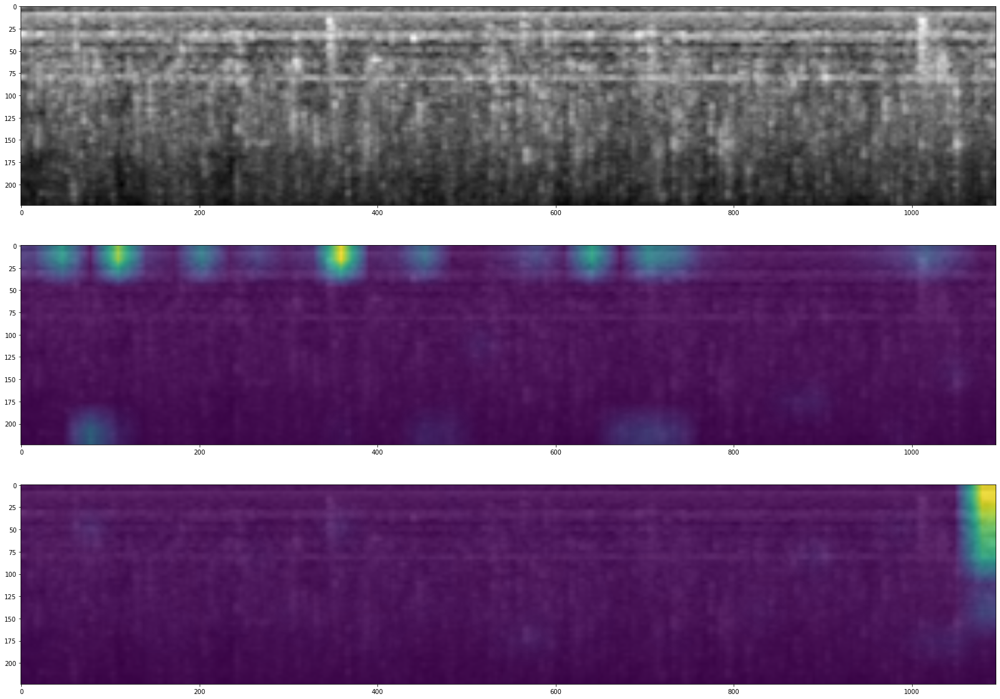

[0. 1.]
0.28045502 0.0 0.9999999


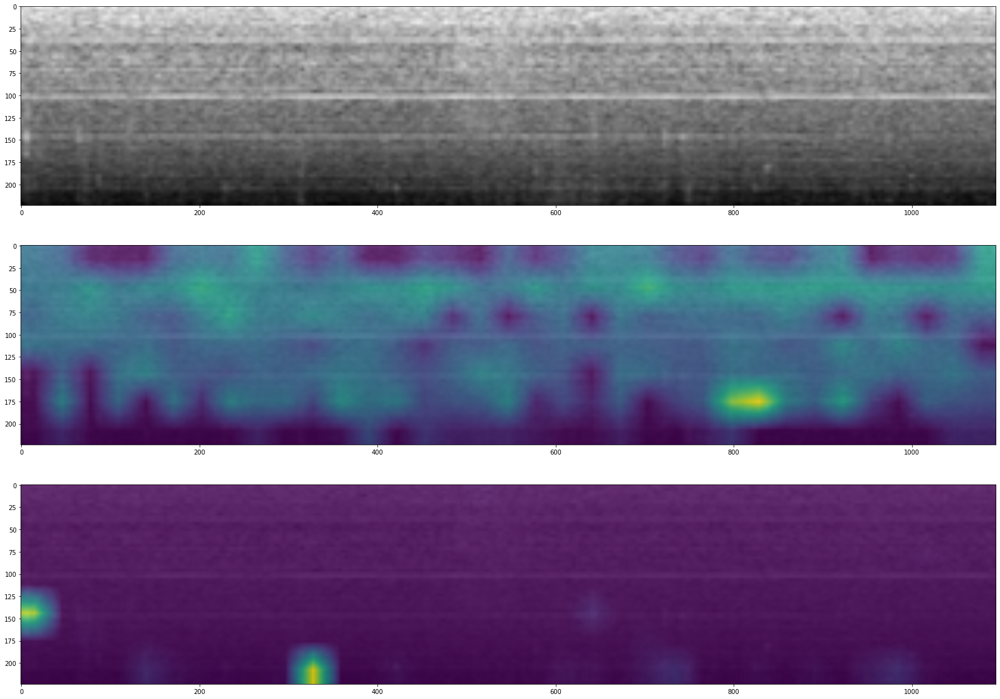

[0. 1.]
0.019392269 0.0 0.9999999


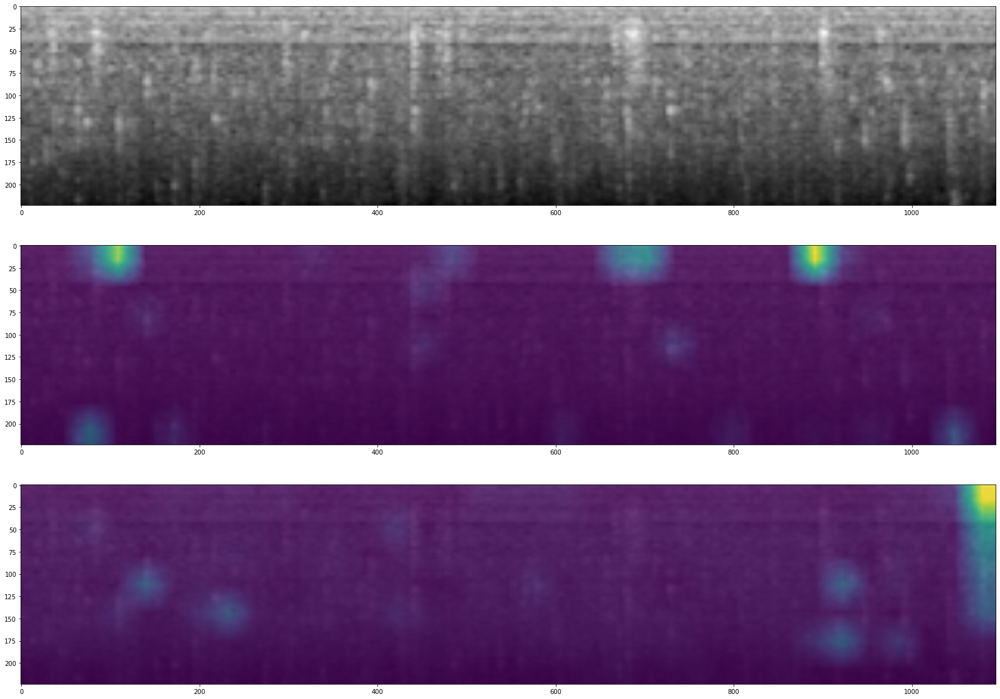

[0. 1.]
0.009663639 0.0 0.9999999


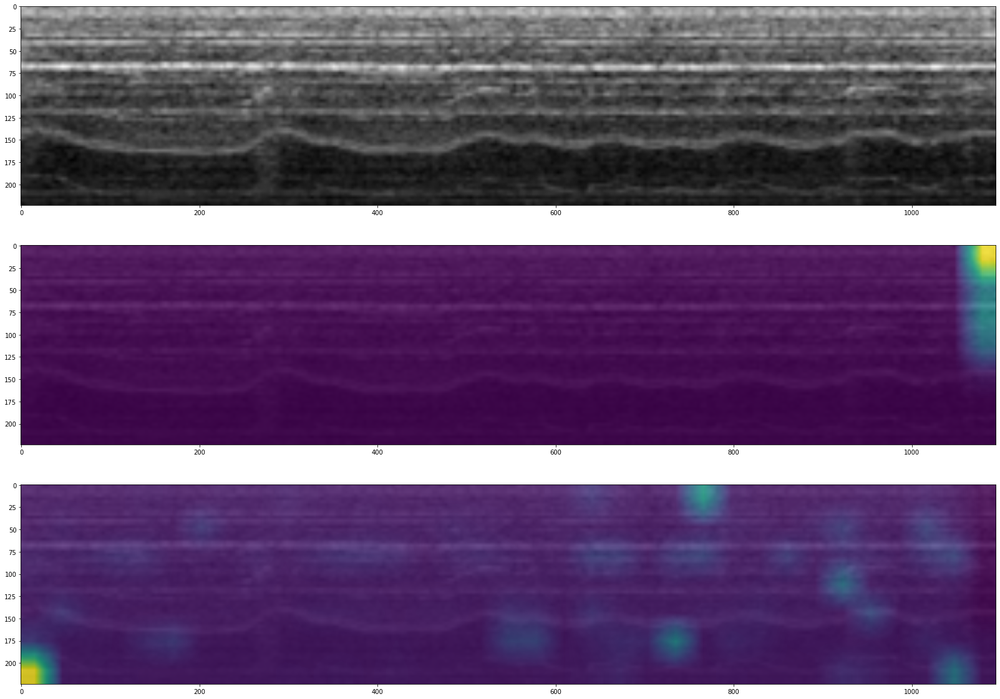

[0. 1.]
0.011246707 0.0 0.9999999


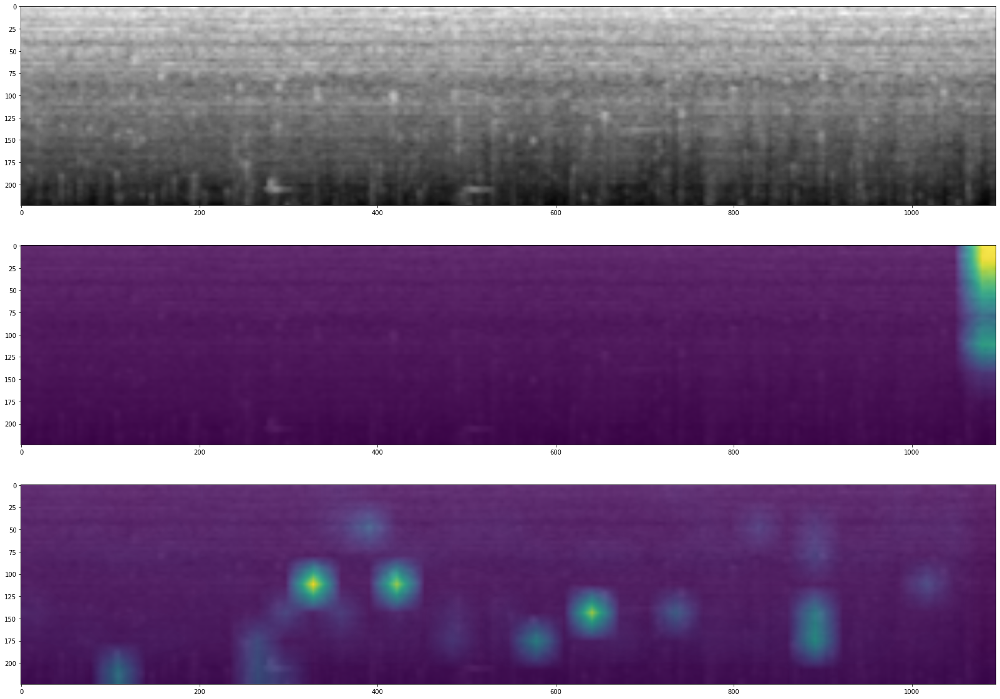

[0. 1.]
0.03393357 0.0 0.9999999


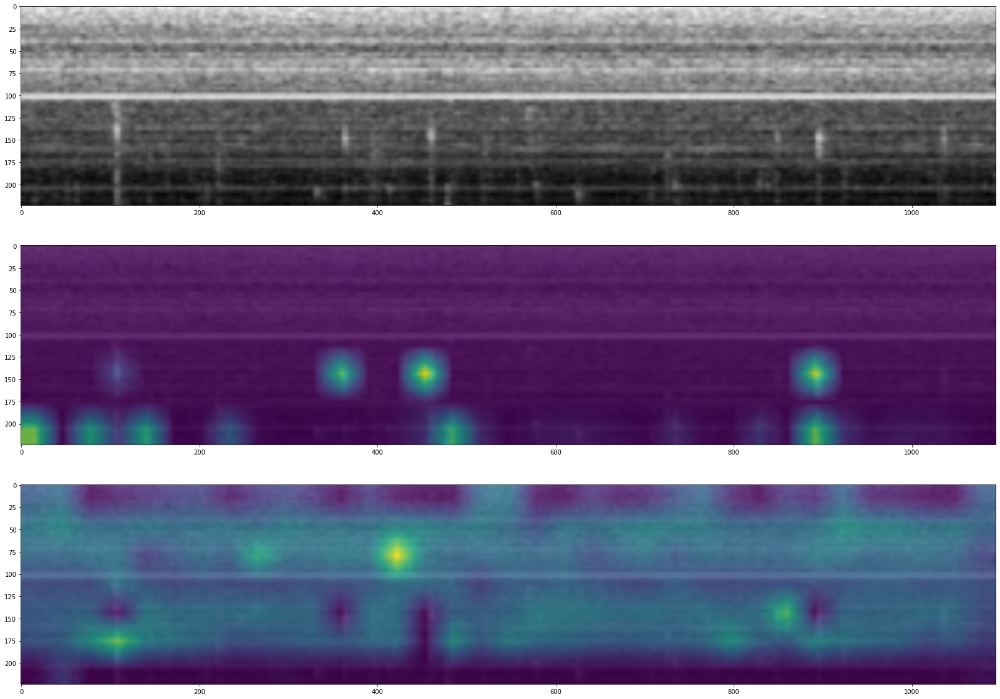

[0. 1.]
0.013012228 0.0 0.9999999


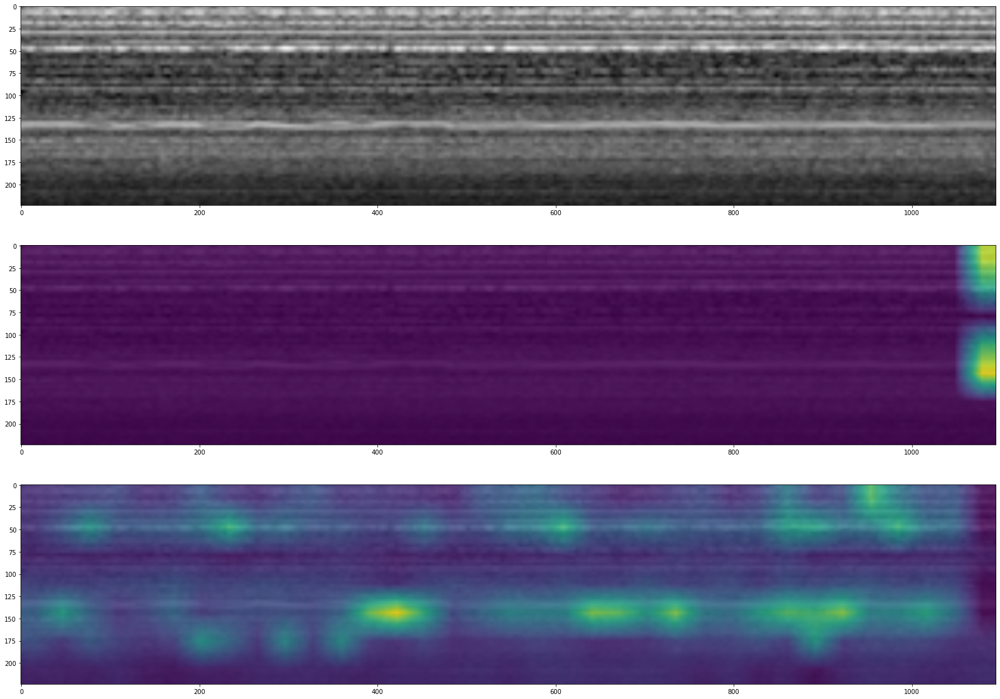

[0. 1.]
0.39548808 0.0 0.9999999


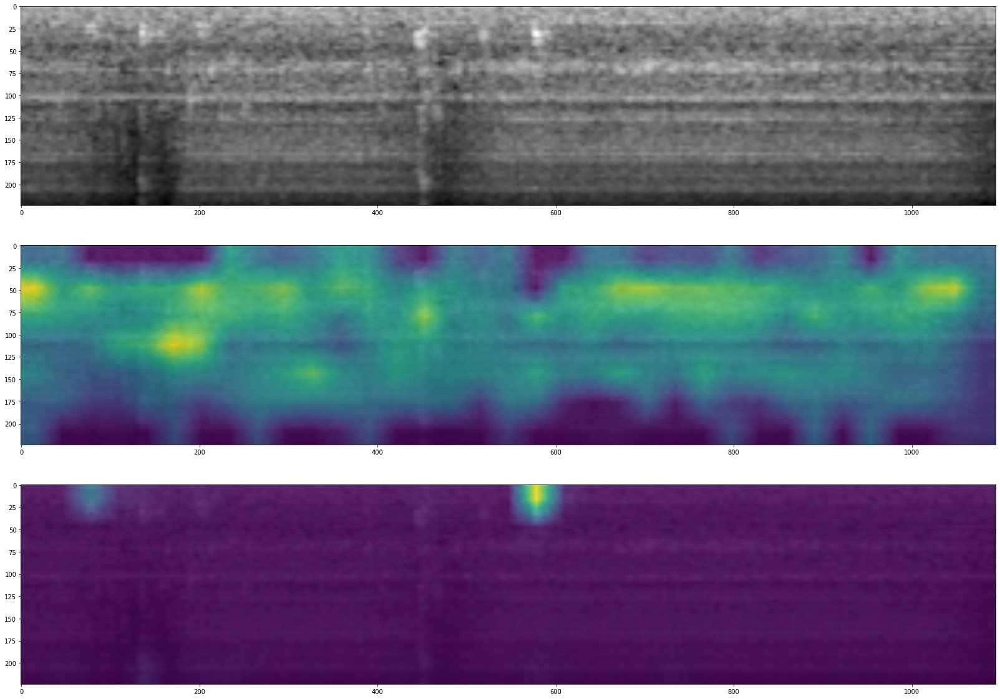

[0. 1.]
0.0048742807 0.0 0.9999999


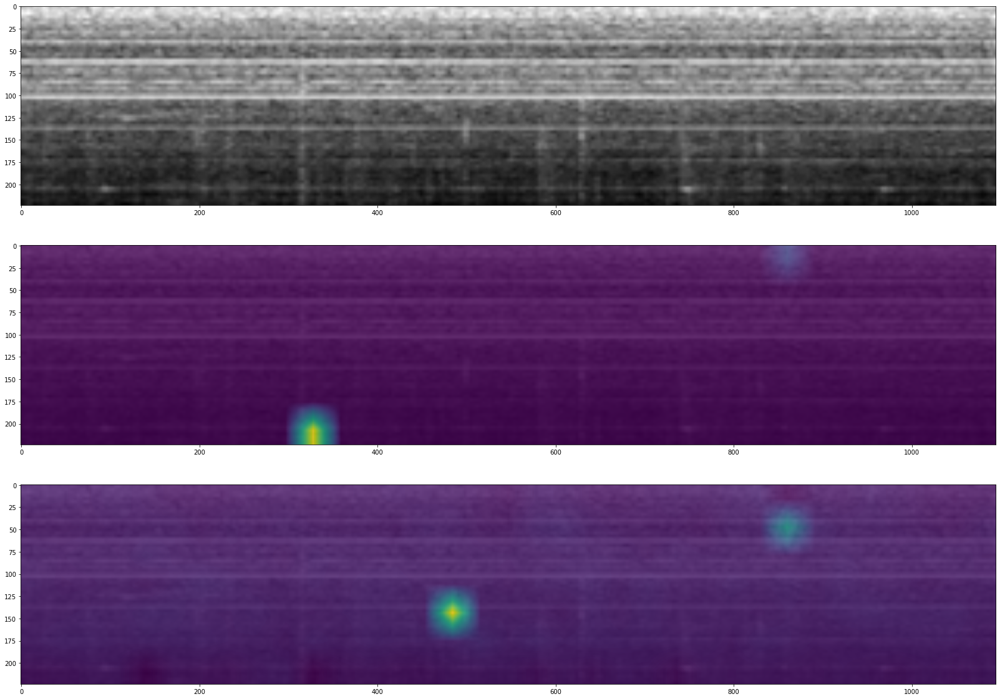

[0. 1.]
0.004340721 0.0 0.9999999


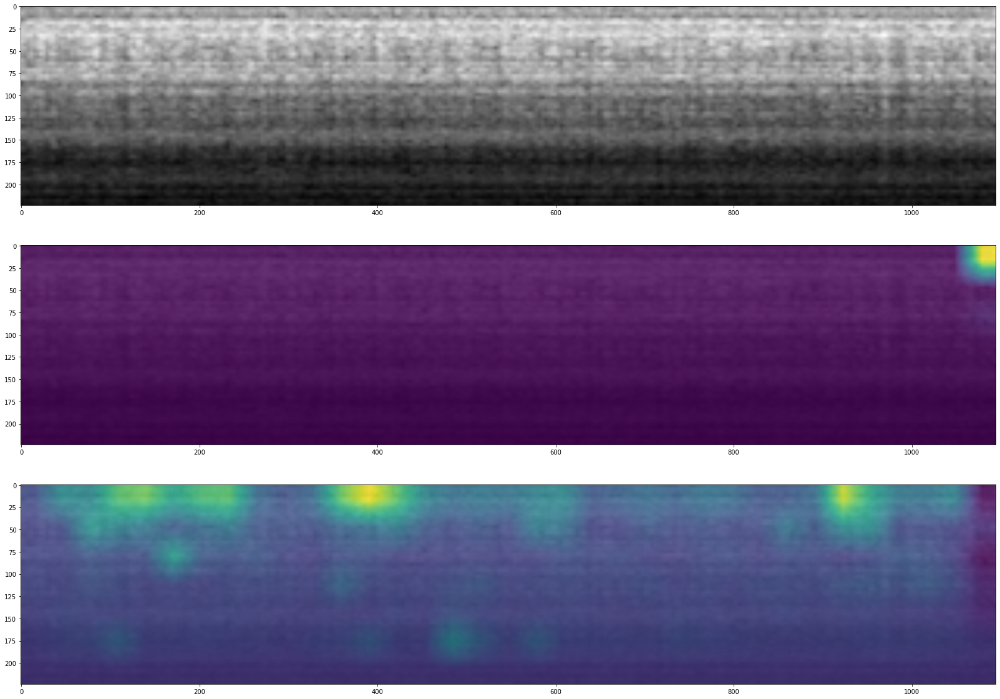

[0. 1.]
0.0125948135 0.0 0.9999998


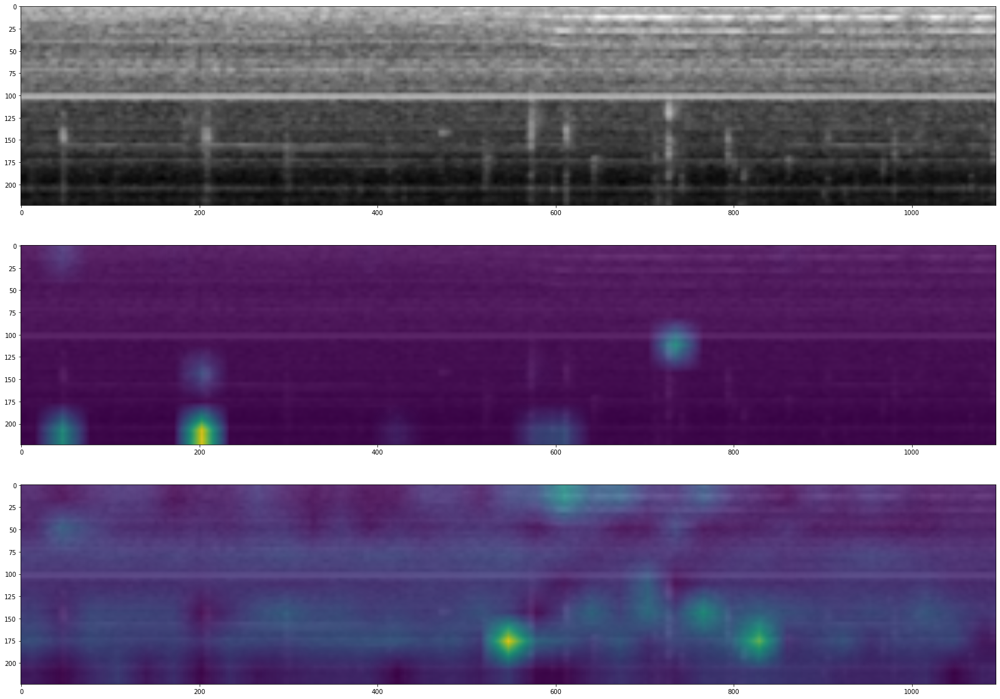

[0. 1.]
0.0 0.0 0.0


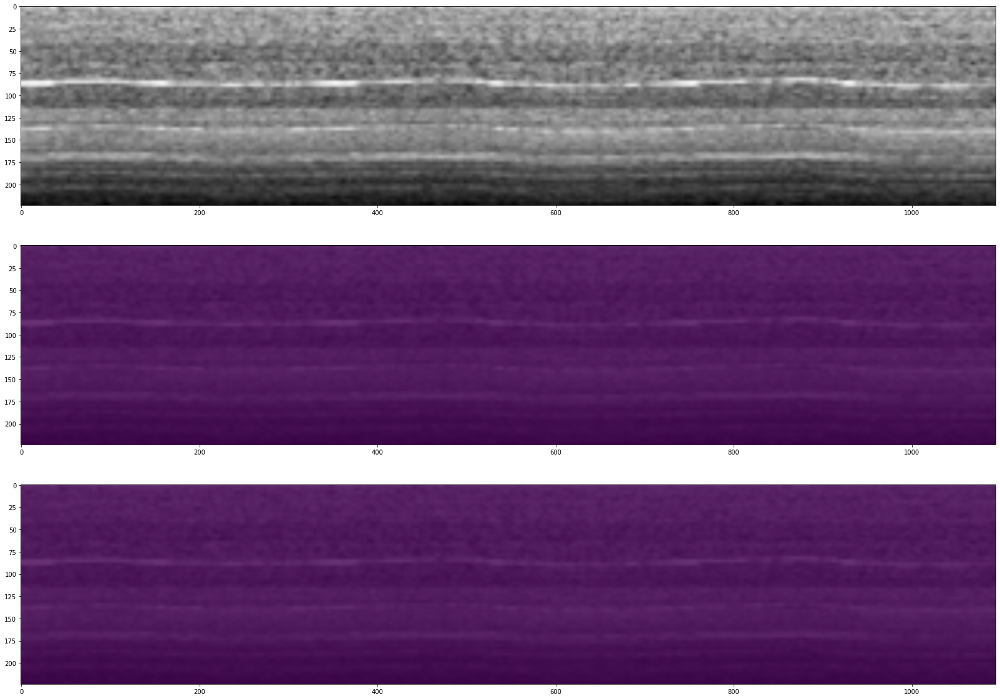

[0. 1.]
0.08030138 0.0 0.9999999


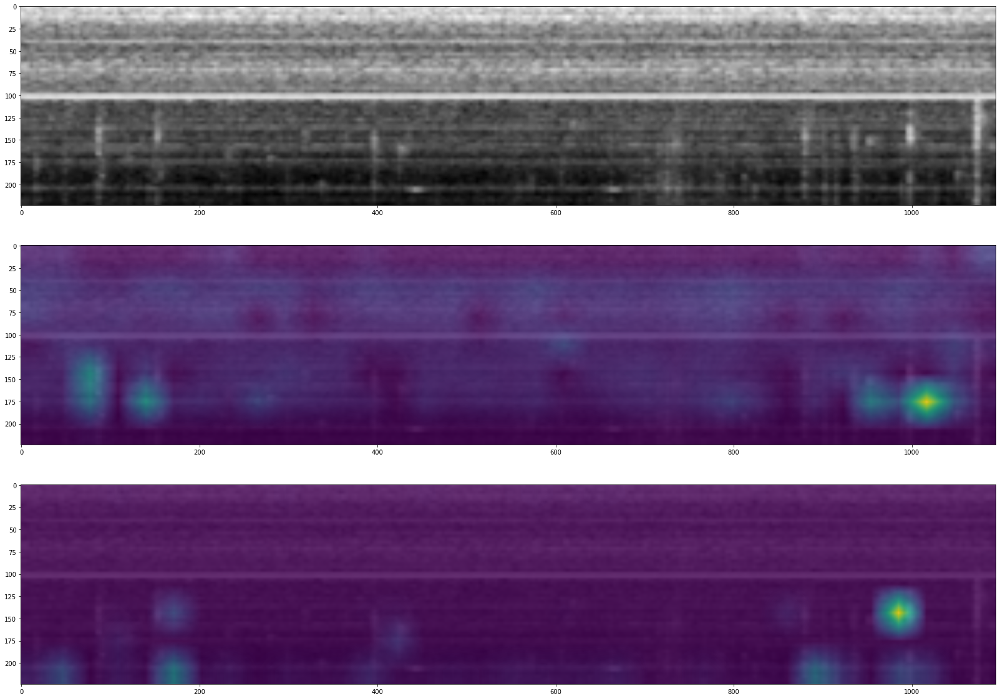

[0. 1.]
0.027859792 0.0 0.9999999


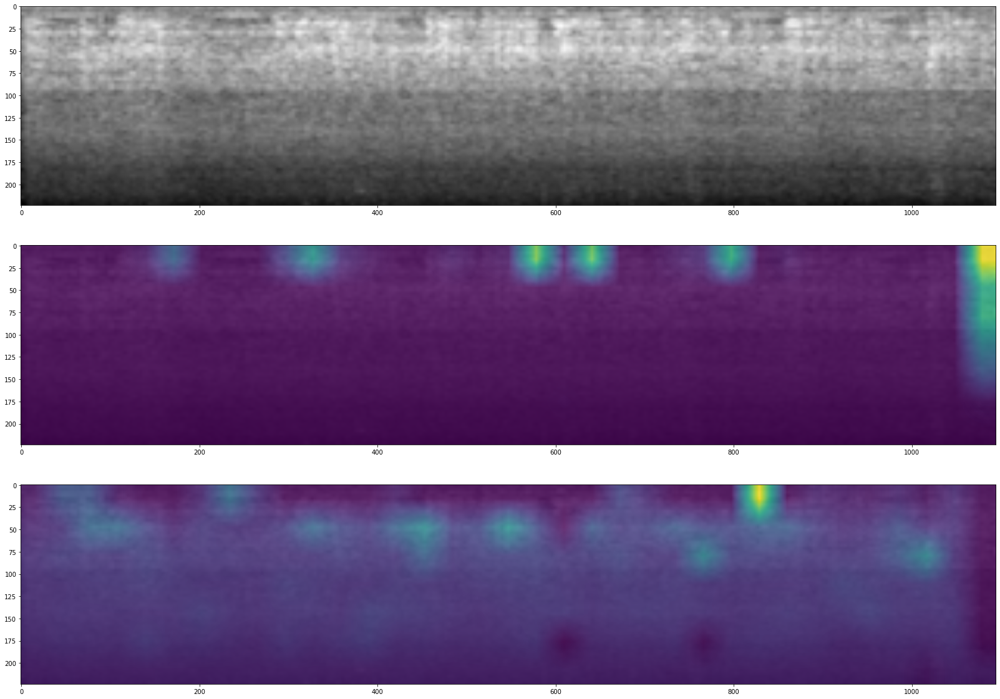

[0. 1.]
0.00813759 0.0 0.9999999


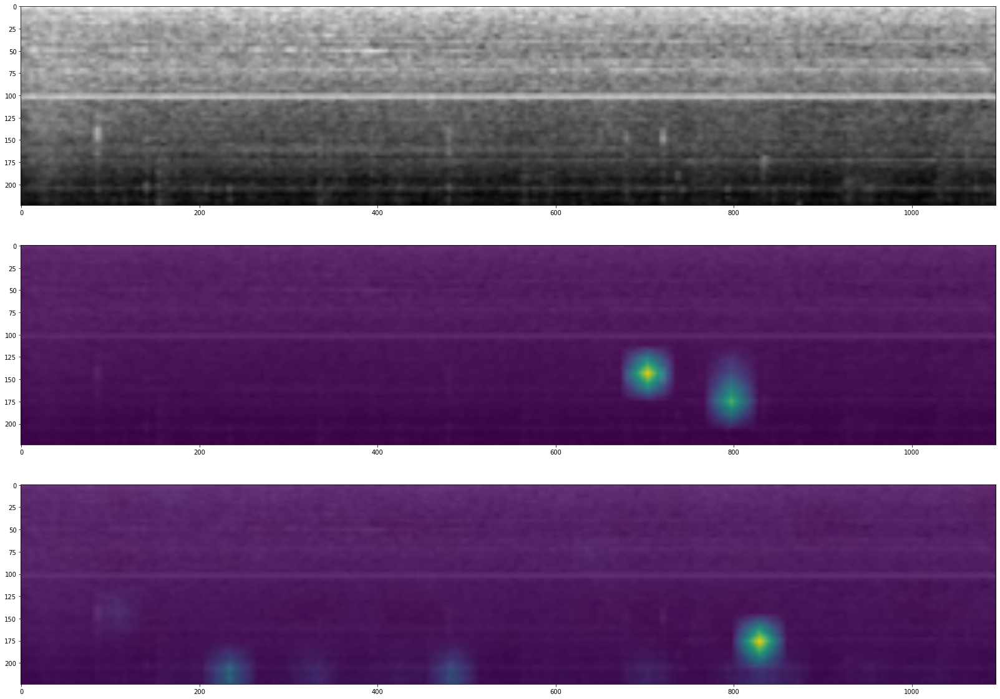

[0. 1.]
0.009582928 0.0 0.9999999


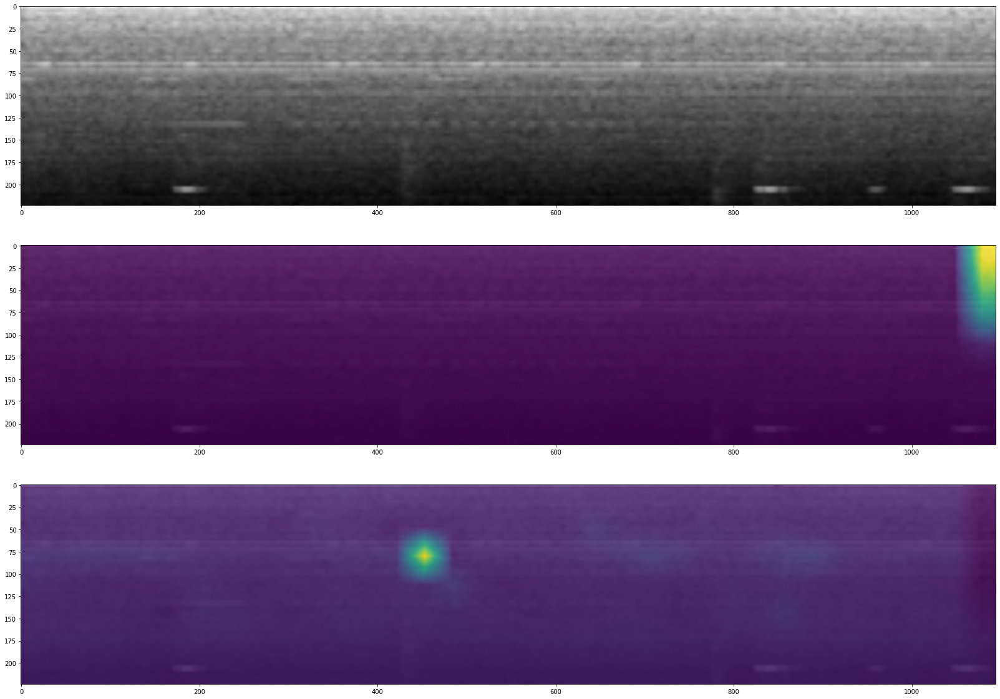

[0. 1.]
0.012116561 0.0 0.9999999


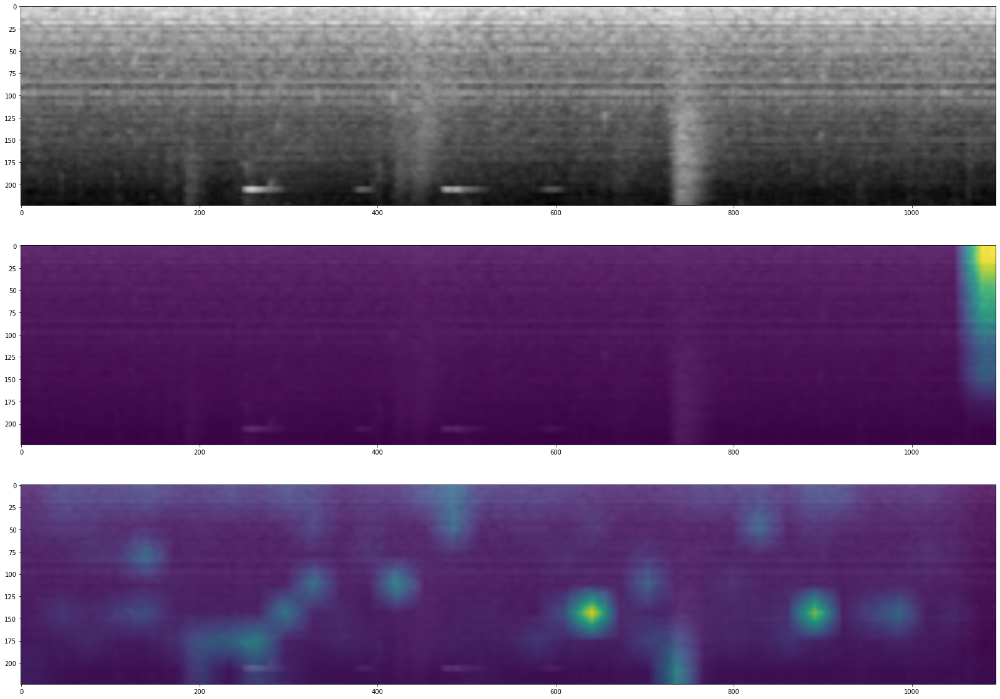

[0. 1.]
0.014327885 0.0 0.9999999


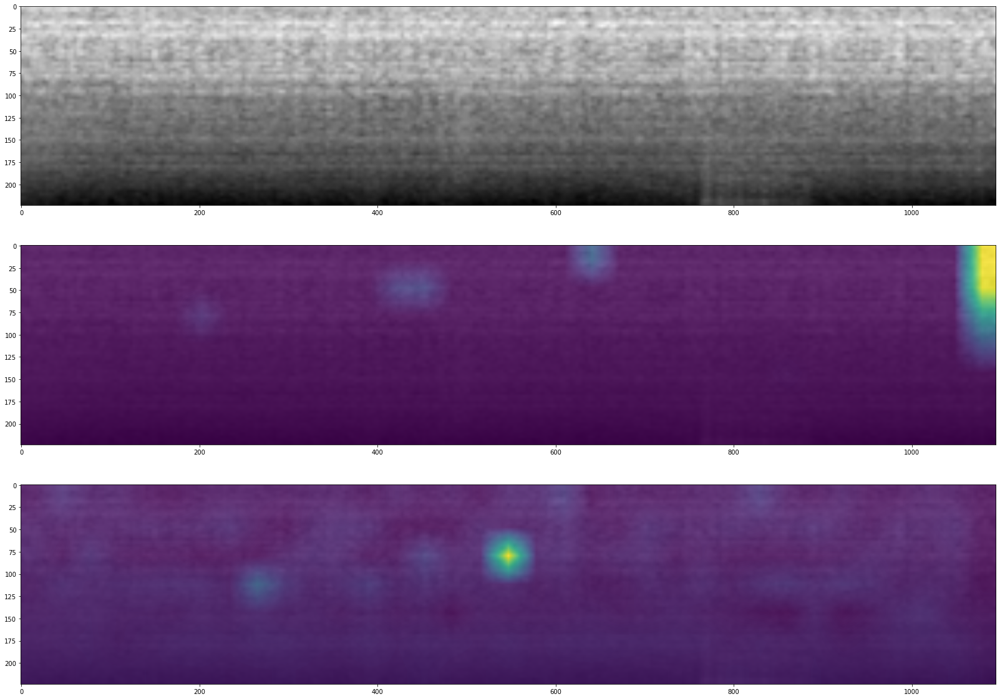

[0. 1.]
0.009023678 0.0 0.9999999


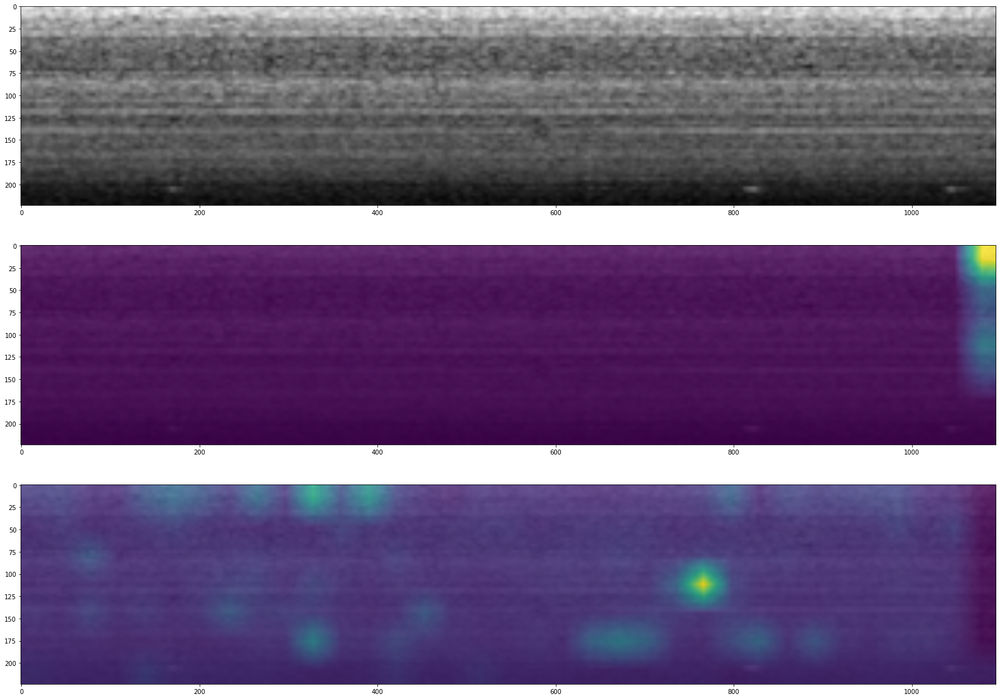

[0. 1.]
0.0 0.0 0.0


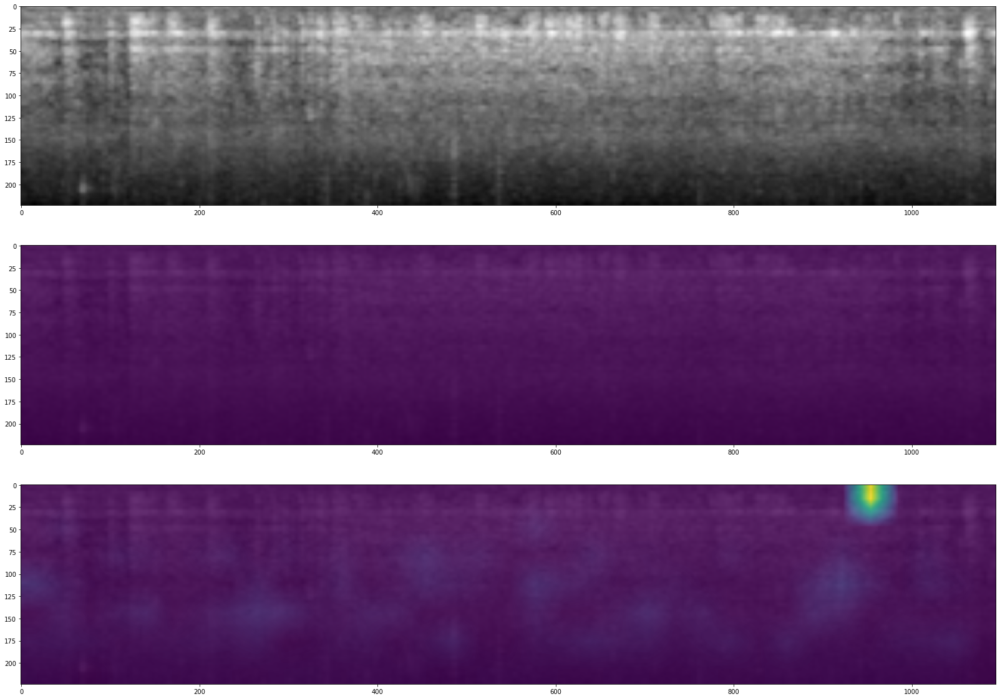

[0. 1.]
0.057797354 0.0 0.9999999


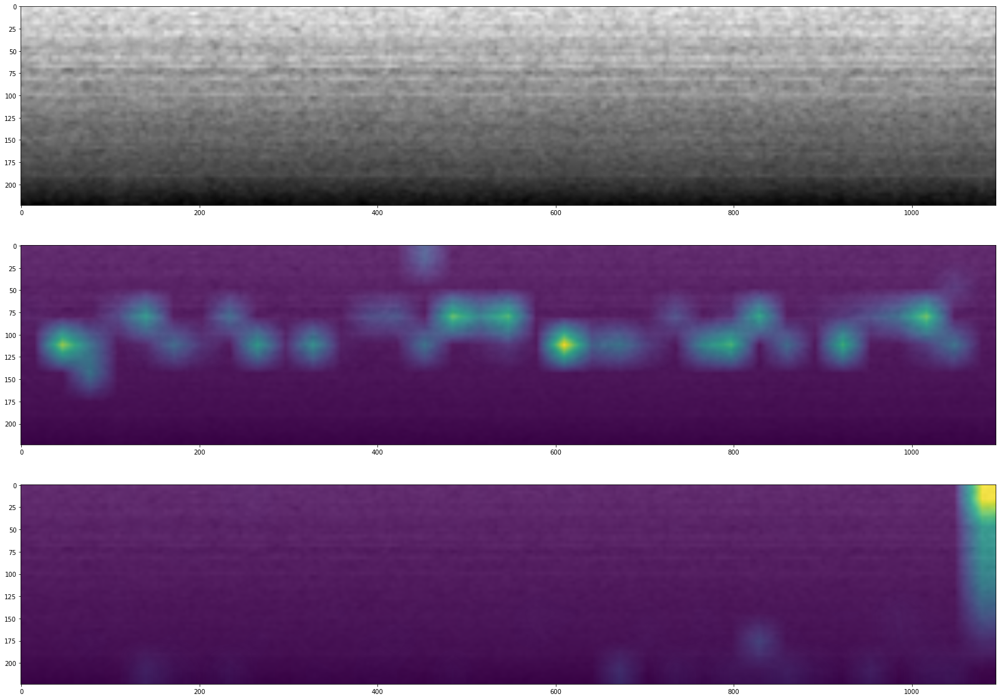

In [37]:
for k in range(21):
    print(target2[k])
    f, ax = plt.subplots(3, 1, figsize=(30, 20))
    ax[0].imshow(np.moveaxis(data2[k], 0, 2))
    print(np.mean(grayscale_cam[k]), np.amin(grayscale_cam[k]), np.amax(grayscale_cam[k]))
    ax[1].imshow(np.moveaxis(data2[k], 0, 2))
    ax[1].imshow(grayscale_cam[k], alpha=0.8)
    ax[2].imshow(np.moveaxis(data2[k], 0, 2))
    ax[2].imshow(grayscale_cam_0[k], alpha=0.8)
    plt.show()

# ROC CURVES

In [ ]:
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
import sklearn


f, ax = plt.subplots(1, 2, figsize=(20,5))
AUCs = []

ax[0].plot([0, 1], [0, 1], 'k--')

ax[1].plot([0, 1], [0, 1], 'k--')

for ii in range(len(target_names)):#[0, 1]:#, 2, 3]:
    fpr_keras, tpr_keras, thresholds_keras = roc_curve(gts[:, ii], preds[:, ii])
    auc_keras = auc(fpr_keras, tpr_keras)
    AUCs.append(auc_keras)
    ax[0].plot(fpr_keras, tpr_keras, label=target_names[ii] + '(area = {:.3f})'.format(auc_keras))

ax[0].set_xlabel('False positive rate')
ax[0].set_ylabel('True positive rate')
ax[0].set_title('ROC curve')
ax[0].legend(loc='best')
print(sum(AUCs[1:])/len(AUCs[1:]))
# for k in AUCs:
#     print(float("%.2f"%k))


import sklearn
AUCs = []
for ii in range(len(target_names)):#[0, 1]:#, 2, 3]:
    precision, recall, _ = sklearn.metrics.precision_recall_curve(gts[:, ii], preds[:, ii])
    auc_keras = auc(recall, precision)
    AUCs.append(auc_keras)
    ax[1].plot(recall, precision, label=target_names[ii] + '(area = {:.3f})'.format(auc_keras))


ax[1].set_xlabel('recall')
ax[1].set_ylabel('precision')
ax[1].set_title('PR Curve')
ax[1].legend(loc='best')
print(sum(AUCs[1:])/len(AUCs[1:]))
#print(AUCs)
plt.show()



# Model failure case visualisation

In [ ]:
# Model failure case visualisation

failed_case_inds = []
correct_pred_inds = []
for ind in range(_preds.shape[0]):
    if _preds[ind] == 3 and _gts[ind] == 0:
        failed_case_inds.append(ind)
    elif _preds[ind] == 3 and _gts[ind] == 3:
        correct_pred_inds.append(ind)
        
fan_normal_inds_all = train_df.index[train_df['machine_type'] == 'fan'].tolist()
pump_normal_inds_all = train_df.index[train_df['machine_type'] == 'pump'].tolist()

In [ ]:
np.set_printoptions(suppress=True)

In [ ]:
n = 10
f_inds = np.random.randint(0,len(failed_case_inds), n)
c_inds = np.random.randint(0,len(correct_pred_inds), n)
fan_normal_inds = np.random.randint(0, len(fan_normal_inds_all), n)
pump_normal_inds = np.random.randint(0, len(pump_normal_inds_all), n)

In [ ]:
import matplotlib.pyplot as plt

for k in range(10):
    img, _ = test_dataset.__getitem__(f_inds[k])
    img = np.moveaxis(img, 0, 2)
    
    img1, _ = test_dataset.__getitem__(c_inds[k])
    img1 = np.moveaxis(img1, 0, 2)
    
    img2, _ = train_dataset.__getitem__(fan_normal_inds[k])
    img2 = np.moveaxis(img2, 0, 2)
    
    img3, _ = train_dataset.__getitem__(pump_normal_inds[k])
    img3 = np.moveaxis(img3, 0, 2)
    
    f, ax = plt.subplots(2, 2, figsize=(40,10))
    ax[0][0].imshow(img[:,:,0])
    ax[0][1].imshow(img1[:,:,0])
    ax[1][0].imshow(img2[:,:,0])
    ax[1][1].imshow(img3[:,:,0])
    plt.show()
    print("-----------------------------------------")